## Packages

In [2]:
from pathlib import Path
import dill
import matplotlib.pyplot as plt
import missingno as msno
import numpy as np
import pandas as pd
import pendulum
import plotly.graph_objects as go
import plotly.express as px
import seaborn as sns
from imblearn.pipeline import Pipeline as imb_Pipeline
from loguru import logger
from sklearn import set_config
from sklearn.compose import make_column_transformer, ColumnTransformer
from sklearn.dummy import DummyClassifier
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (confusion_matrix,
                             classification_report,
                             ConfusionMatrixDisplay,
                             roc_auc_score,
                             accuracy_score,
                             precision_score,
                             recall_score,
                             f1_score,
                             RocCurveDisplay,
                             PrecisionRecallDisplay,
                            )
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, OrdinalEncoder, OneHotEncoder
from ucimlrepo import fetch_ucirepo, list_available_datasets
from yellowbrick.classifier import DiscriminationThreshold

set_config(display='diagram')
pd.set_option("display.max_columns", None)

# Data collection

In [4]:
HOME_DIR = Path("data")
DATA_TRAIN = HOME_DIR / "training.csv"
HOME_DIR.mkdir(parents=True, exist_ok=True)
print(f"Work directory: {HOME_DIR} \nData directory: {DATA_TRAIN}")

Work directory: C:\Users\HP\Desktop\Livrables_groupe6\DATA 
Data directory: C:\Users\HP\Desktop\Livrables_groupe6\DATA\training.csv


In [5]:
df = pd.read_csv(DATA_TRAIN, sep=";")
df.head()

,TransactionId,BatchId,AccountId,SubscriptionId,CustomerId,CurrencyCode,CountryCode,ProviderId,ProductId,ProductCategory,ChannelId,Amount,Value,TransactionStartTime,PricingStrategy,FraudResult
0,TransactionId_76871,BatchId_36123,AccountId_3957,SubscriptionId_887,CustomerId_4406,UGX,256,ProviderId_6,ProductId_10,airtime,ChannelId_3,1000.0,1000,2018-11-15T02:18:49Z,2,0
1,TransactionId_73770,BatchId_15642,AccountId_4841,SubscriptionId_3829,CustomerId_4406,UGX,256,ProviderId_4,ProductId_6,financial_services,ChannelId_2,-20.0,20,2018-11-15T02:19:08Z,2,0
2,TransactionId_26203,BatchId_53941,AccountId_4229,SubscriptionId_222,CustomerId_4683,UGX,256,ProviderId_6,ProductId_1,airtime,ChannelId_3,500.0,500,2018-11-15T02:44:21Z,2,0
3,TransactionId_380,BatchId_102363,AccountId_648,SubscriptionId_2185,CustomerId_988,UGX,256,ProviderId_1,ProductId_21,utility_bill,ChannelId_3,20000.0,21800,2018-11-15T03:32:55Z,2,0
4,TransactionId_28195,BatchId_38780,AccountId_4841,SubscriptionId_3829,CustomerId_988,UGX,256,ProviderId_4,ProductId_6,financial_services,ChannelId_2,-644.0,644,2018-11-15T03:34:21Z,2,0


In [6]:
df.tail()

,TransactionId,BatchId,AccountId,SubscriptionId,CustomerId,CurrencyCode,CountryCode,ProviderId,ProductId,ProductCategory,ChannelId,Amount,Value,TransactionStartTime,PricingStrategy,FraudResult
95657,TransactionId_89881,BatchId_96668,AccountId_4841,SubscriptionId_3829,CustomerId_3078,UGX,256,ProviderId_4,ProductId_6,financial_services,ChannelId_2,-1000.0,1000,2019-02-13T09:54:09Z,2,0
95658,TransactionId_91597,BatchId_3503,AccountId_3439,SubscriptionId_2643,CustomerId_3874,UGX,256,ProviderId_6,ProductId_10,airtime,ChannelId_3,1000.0,1000,2019-02-13T09:54:25Z,2,0
95659,TransactionId_82501,BatchId_118602,AccountId_4841,SubscriptionId_3829,CustomerId_3874,UGX,256,ProviderId_4,ProductId_6,financial_services,ChannelId_2,-20.0,20,2019-02-13T09:54:35Z,2,0
95660,TransactionId_136354,BatchId_70924,AccountId_1346,SubscriptionId_652,CustomerId_1709,UGX,256,ProviderId_6,ProductId_19,tv,ChannelId_3,3000.0,3000,2019-02-13T10:01:10Z,2,0
95661,TransactionId_35670,BatchId_29317,AccountId_4841,SubscriptionId_3829,CustomerId_1709,UGX,256,ProviderId_4,ProductId_6,financial_services,ChannelId_2,-60.0,60,2019-02-13T10:01:28Z,2,0


In [7]:
df.shape

(95662, 16)

In [8]:
df.dtypes

TransactionId            object
BatchId                  object
AccountId                object
SubscriptionId           object
CustomerId               object
CurrencyCode             object
CountryCode               int64
ProviderId               object
ProductId                object
ProductCategory          object
ChannelId                object
Amount                  float64
Value                     int64
TransactionStartTime     object
PricingStrategy           int64
FraudResult               int64
dtype: object

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 95662 entries, 0 to 95661
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   TransactionId         95662 non-null  object 
 1   BatchId               95662 non-null  object 
 2   AccountId             95662 non-null  object 
 3   SubscriptionId        95662 non-null  object 
 4   CustomerId            95662 non-null  object 
 5   CurrencyCode          95662 non-null  object 
 6   CountryCode           95662 non-null  int64  
 7   ProviderId            95662 non-null  object 
 8   ProductId             95662 non-null  object 
 9   ProductCategory       95662 non-null  object 
 10  ChannelId             95662 non-null  object 
 11  Amount                95662 non-null  float64
 12  Value                 95662 non-null  int64  
 13  TransactionStartTime  95662 non-null  object 
 14  PricingStrategy       95662 non-null  int64  
 15  FraudResult        

In [10]:
df.duplicated().sum()

0

In [11]:
df.isnull().sum()

TransactionId           0
BatchId                 0
AccountId               0
SubscriptionId          0
CustomerId              0
CurrencyCode            0
CountryCode             0
ProviderId              0
ProductId               0
ProductCategory         0
ChannelId               0
Amount                  0
Value                   0
TransactionStartTime    0
PricingStrategy         0
FraudResult             0
dtype: int64

In [12]:
df.describe(include = "all")

,TransactionId,BatchId,AccountId,SubscriptionId,CustomerId,CurrencyCode,CountryCode,ProviderId,ProductId,ProductCategory,ChannelId,Amount,Value,TransactionStartTime,PricingStrategy,FraudResult
count,95662,95662,95662,95662,95662,95662,95662.0,95662,95662,95662,95662,9.566200e+04,9.566200e+04,95662,95662.000000,95662.000000
unique,95662,94809,3633,3627,3742,1,NaN,6,23,9,4,NaN,NaN,94556,NaN,NaN
top,TransactionId_76871,BatchId_67019,AccountId_4841,SubscriptionId_3829,CustomerId_7343,UGX,NaN,ProviderId_4,ProductId_6,financial_services,ChannelId_3,NaN,NaN,2018-12-24T16:30:13Z,NaN,NaN
freq,1,28,30893,32630,4091,95662,NaN,38189,32635,45405,56935,NaN,NaN,17,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,256.0,NaN,NaN,NaN,NaN,6.717846e+03,9.900584e+03,NaN,2.255974,0.002018
std,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,1.233068e+05,1.231221e+05,NaN,0.732924,0.044872
min,NaN,NaN,NaN,NaN,NaN,NaN,256.0,NaN,NaN,NaN,NaN,-1.000000e+06,2.000000e+00,NaN,0.000000,0.000000
25%,NaN,NaN,NaN,NaN,NaN,NaN,256.0,NaN,NaN,NaN,NaN,-5.000000e+01,2.750000e+02,NaN,2.000000,0.000000
50%,NaN,NaN,NaN,NaN,NaN,NaN,256.0,NaN,NaN,NaN,NaN,1.000000e+03,1.000000e+03,NaN,2.000000,0.000000
75%,NaN,NaN,NaN,NaN,NaN,NaN,256.0,NaN,NaN,NaN,NaN,2.800000e+03,5.000000e+03,NaN,2.000000,0.000000


# EDA: Exploratory Data Analysis

In [14]:
df['PricingStrategy'] = df['PricingStrategy'].astype('str')


In [15]:
df["FraudResult"].value_counts(normalize=False)

FraudResult
0    95469
1      193
Name: count, dtype: int64

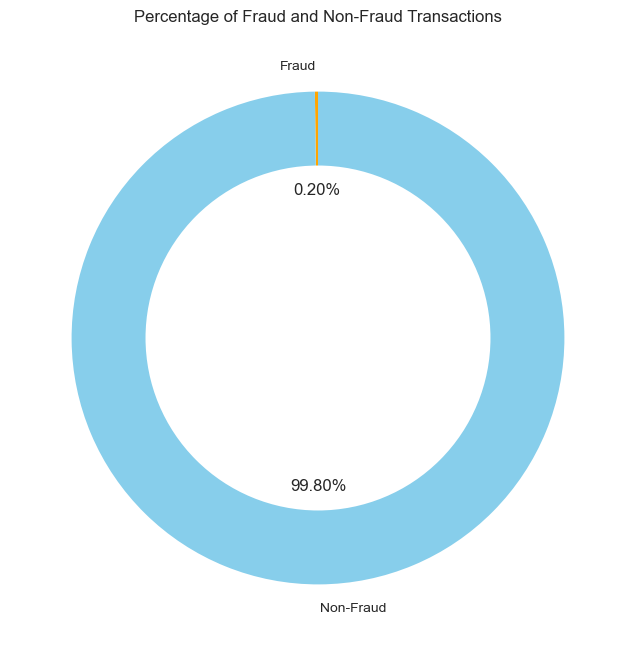

In [16]:
# Comptage des transactions frauduleuses et non frauduleuses
fraud_count = df[df["FraudResult"] == 1].shape[0]
non_fraud_count = df[df["FraudResult"] == 0].shape[0]

# Calcul des pourcentages
total = fraud_count + non_fraud_count
fraud_percentage = (fraud_count / total) * 100
non_fraud_percentage = (non_fraud_count / total) * 100

# Préparation des données pour le graphique
labels = ['Fraud', 'Non-Fraud']
sizes = [fraud_percentage, non_fraud_percentage]
colors = ['orange', 'skyblue']

# Création du graphique
fig, ax = plt.subplots(figsize=(8, 8))
ax.pie(sizes, labels=labels, autopct='%1.2f%%', startangle=90, colors=colors)

# Cercle central pour un effet "donut"
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig.gca().add_artist(centre_circle)

# Titre du graphique
plt.title('Percentage of Fraud and Non-Fraud Transactions')
plt.show()


In [17]:
categorical_columns = df.select_dtypes(include="object").columns
categorical_columns

Index(['TransactionId', 'BatchId', 'AccountId', 'SubscriptionId', 'CustomerId',
       'CurrencyCode', 'ProviderId', 'ProductId', 'ProductCategory',
       'ChannelId', 'TransactionStartTime', 'PricingStrategy'],
      dtype='object')

In [18]:
for col_name in categorical_columns:
    logger.info(f"{col_name} ==============\n {df[col_name].value_counts(dropna=False)}\n")

2025-05-08 11:25:43.423 | INFO     | __main__:<module>:2 - TransactionId ==============
 TransactionId
TransactionId_76871     1
TransactionId_74922     1
TransactionId_2737      1
TransactionId_28101     1
TransactionId_33267     1
                       ..
TransactionId_32860     1
TransactionId_139405    1
TransactionId_65784     1
TransactionId_8889      1
TransactionId_35670     1
Name: count, Length: 95662, dtype: int64

2025-05-08 11:25:43.461 | INFO     | __main__:<module>:2 - BatchId ==============
 BatchId
BatchId_67019     28
BatchId_51870     16
BatchId_113893    14
BatchId_127204    12
BatchId_116835    10
                  ..
BatchId_23939      1
BatchId_104215     1
BatchId_116411     1
BatchId_36631      1
BatchId_29317      1
Name: count, Length: 94809, dtype: int64

2025-05-08 11:25:43.467 | INFO     | __main__:<module>:2 - AccountId ==============
 AccountId
AccountId_4841    30893
AccountId_4249     4457
AccountId_4840     1738
AccountId_3206     1105
AccountId_318 

In [19]:
# Création des variables dérivées de AccountId, SubscriptionId, CustomerId
df['CustomerId_abs_amount_sum'] = df.groupby('CustomerId')['Amount'].transform(lambda x: x.abs().sum())
df['SubscriptionId_transaction_count'] = df.groupby('SubscriptionId')['TransactionId'].transform('count')
df['CustomerId_abs_amount_std'] = df.groupby('CustomerId')['Amount'].transform(lambda x: x.abs().std())
df['CustomerId_abs_amount_std'] = df['CustomerId_abs_amount_std'].fillna(0)

In [20]:
# Création des variables dérivées de TransactionStartTime
# Variable transaction_type (crédit ou débit)
df['TransactionType'] = df['Amount'].apply(lambda x: 'Credit' if x < 0 else 'Debit').astype('object')

# Conversion de la variable temporelle
df['TransactionStartTime'] = pd.to_datetime(df['TransactionStartTime'])

# Extraction des informations utiles
df['TransactionHour'] = df['TransactionStartTime'].dt.hour
df['TransactionDay'] = df['TransactionStartTime'].dt.day_name(locale='fr_FR')

# Création de la variable MomentOfDay
def get_moment(hour):
    if 6 <= hour < 13:
        return 'matin'
    elif 13 <= hour <= 20:
        return 'apres-midi'
    else:
        return 'nuit'

df['MomentOfDay'] = df['TransactionHour'].apply(get_moment)



In [21]:
# Vérifie si chaque ProductId correspond à une seule ProductCategory
mapping_check = df.groupby("ProductId")["ProductCategory"].nunique()
print("Nombre de ProductId ayant plus d'une catégorie :", (mapping_check > 1).sum())


Nombre de ProductId ayant plus d'une catégorie : 0


In [22]:
# Certaines colonnes n’apportent pas d'information utile au modèle
cols_to_drop = ['TransactionId', 'BatchId', 'CustomerId','AccountId', 'SubscriptionId', 
                'CountryCode', 'CurrencyCode','TransactionStartTime','TransactionHour','ProductCategory']
df.drop(columns=cols_to_drop, inplace=True)

## Analyse univariée avec les variables catégorielles  

In [24]:
categorical_columns = df.select_dtypes(include="object").columns
categorical_columns

Index(['ProviderId', 'ProductId', 'ChannelId', 'PricingStrategy',
       'TransactionType', 'TransactionDay', 'MomentOfDay'],
      dtype='object')

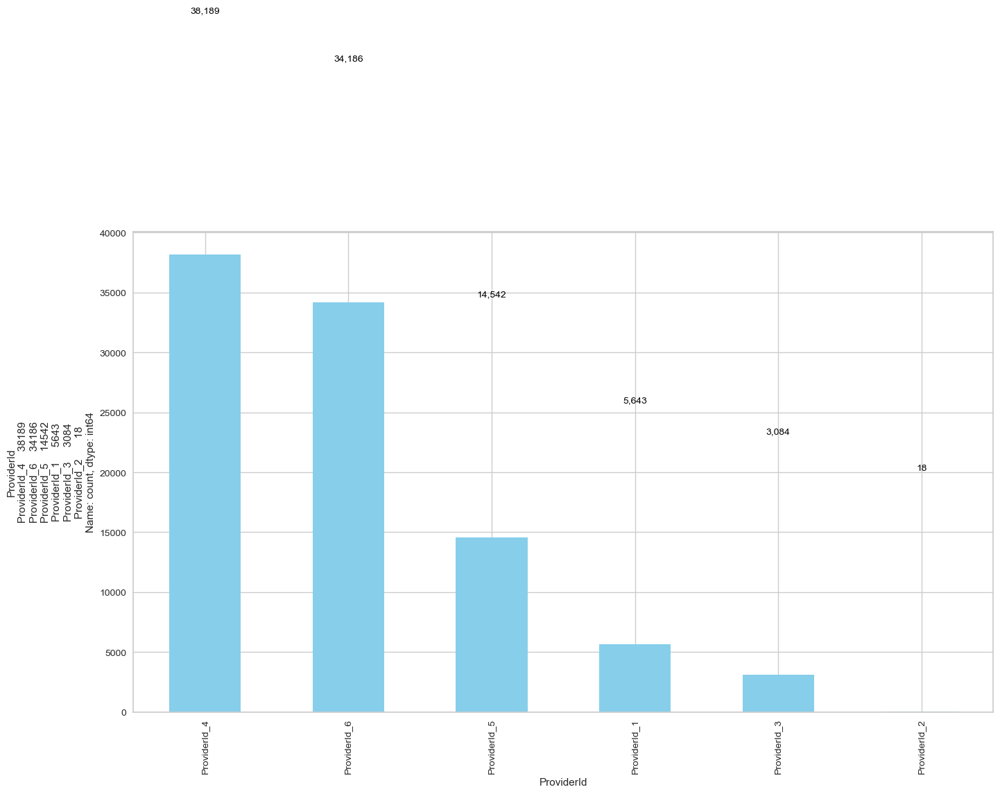

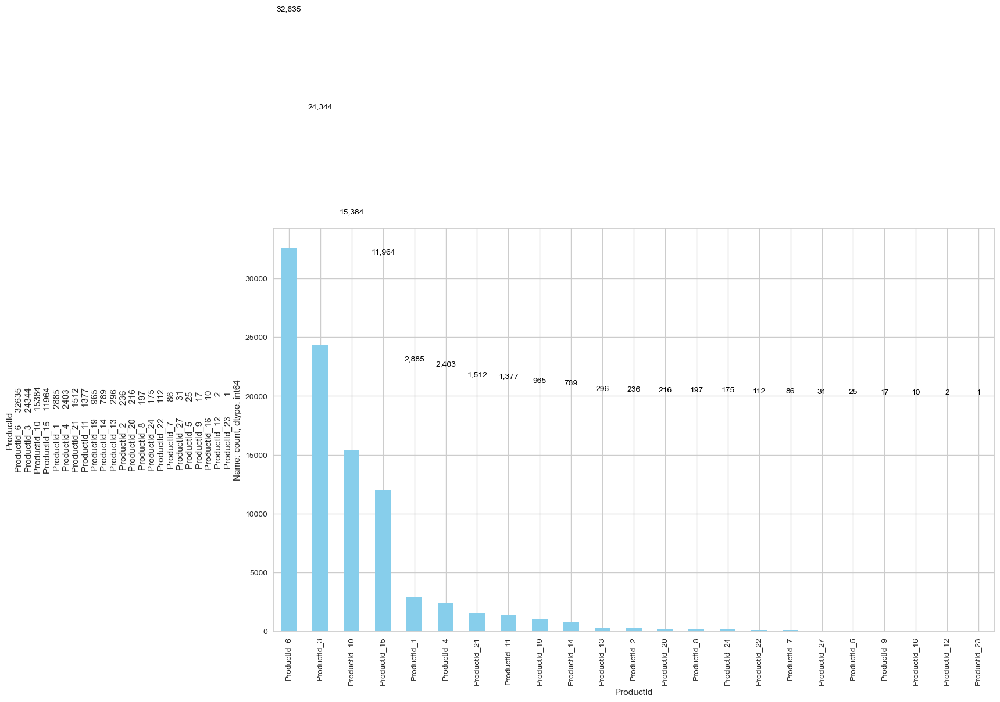

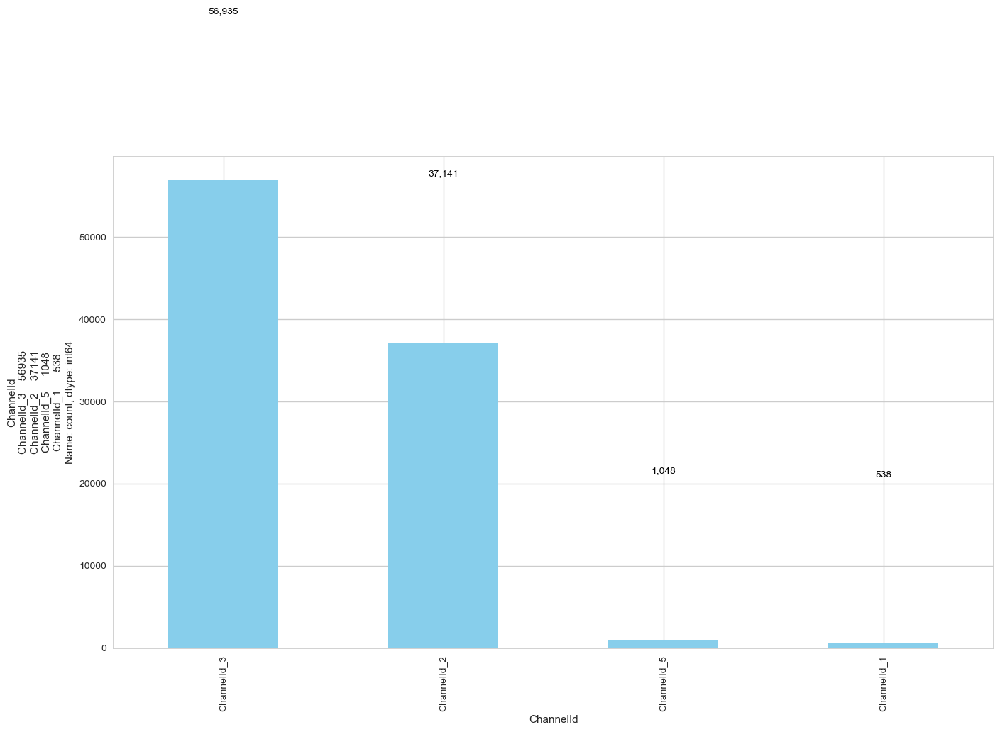

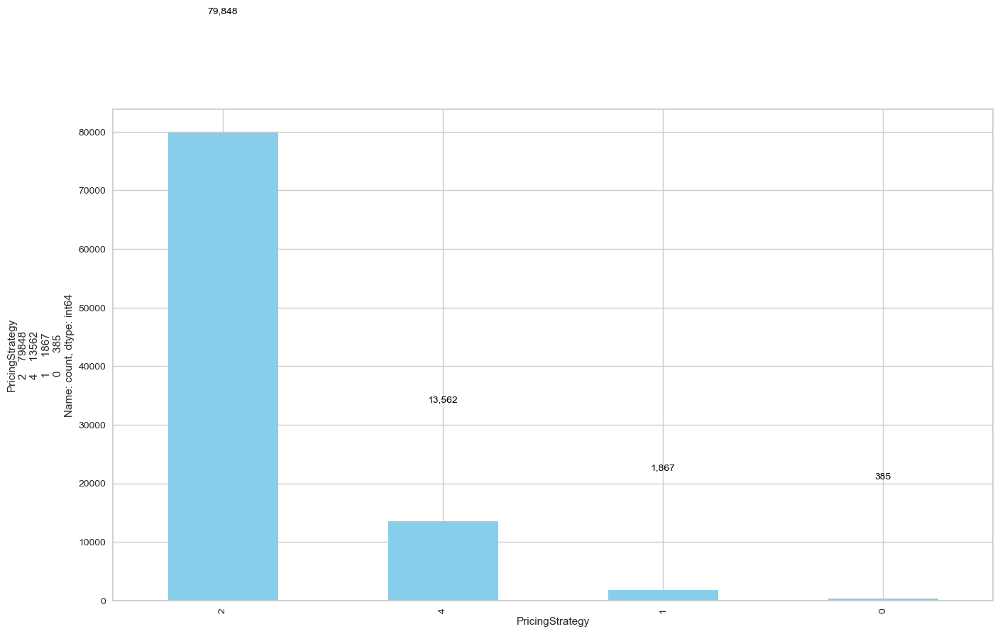

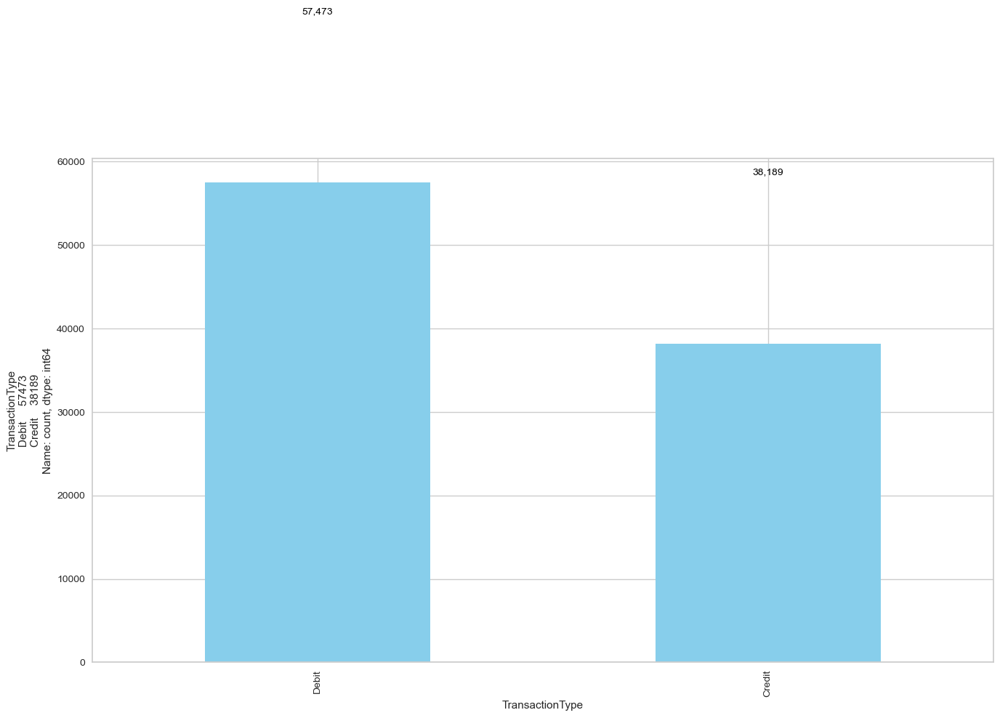

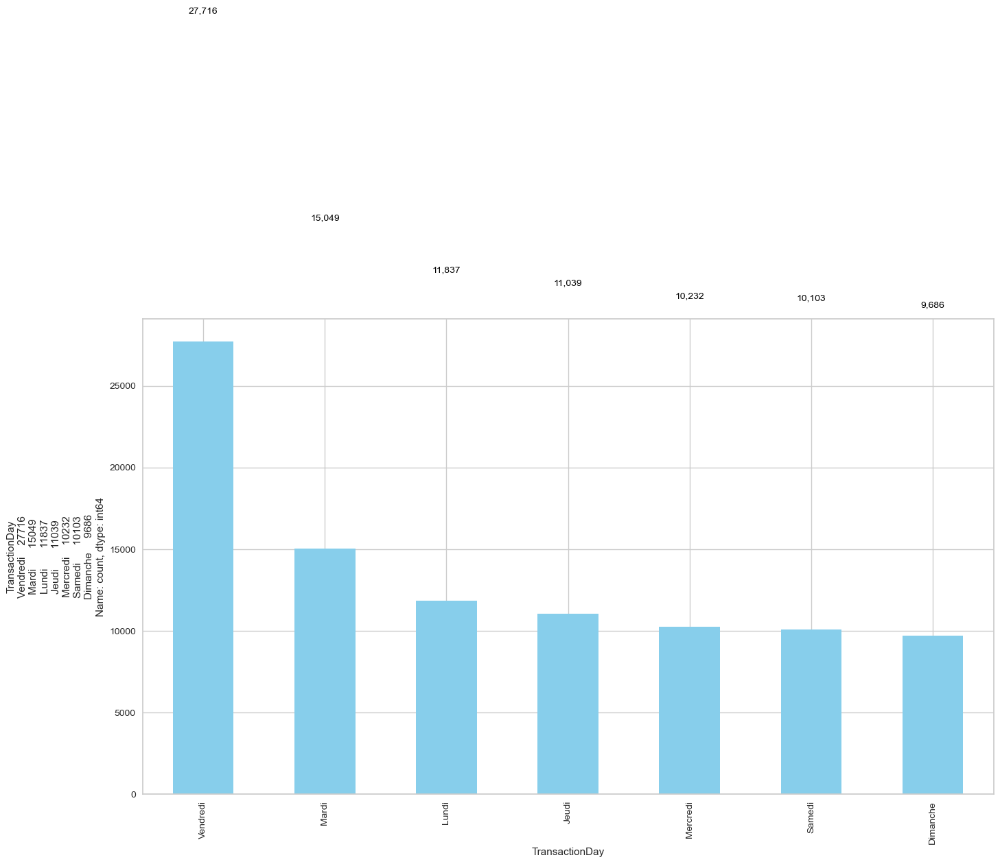

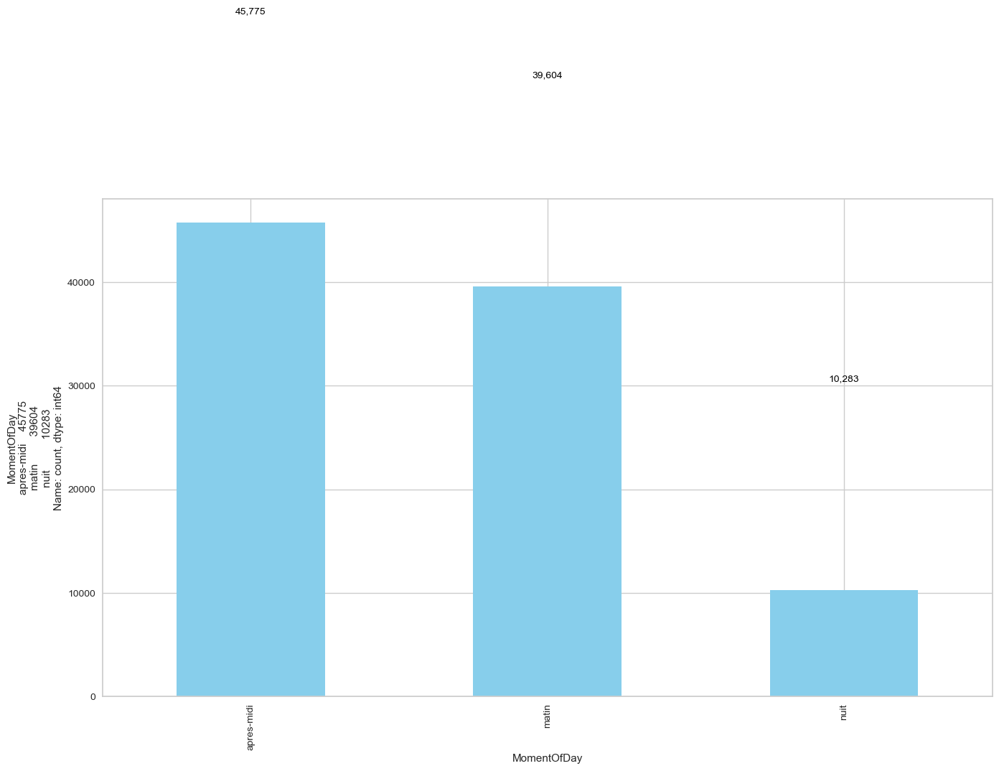

In [25]:
for col in categorical_columns:
    unique_col = df[col].unique();
    col_counts = df[col].value_counts()
    plt.figure(figsize=(16, 9))
    plt.xlabel(unique_col)
    plt.ylabel(col_counts)
    bars = col_counts.plot(kind='bar', color='skyblue')
    for bar in bars.patches:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, yval + 20000, f'{yval:,.0f}', ha='center', va='bottom', fontsize=10, color='black')
    plt.show()

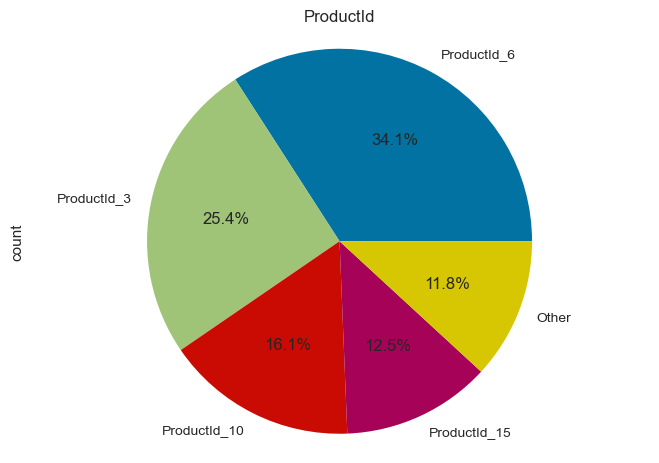

In [26]:
# Recoder la variable ProduitId 
# Calculer la fréquence des produits
frequencies_product = df['ProductId'].value_counts(normalize=True) * 100

# Sélectionner les produits dont la fréquence dépasse 12%
products_above_12 = frequencies_product[frequencies_product > 12]
products_list = products_above_12.index.tolist()
def recode_product(X):
  try:
        if 'ProductId' in X.columns:
            X = X.copy()
            X['ProductId'] = X['ProductId'].apply(lambda x: x if x in products_list else 'Other')
        return X
  except:
        print("Vérifier la liste des colonnes")

df = recode_product(df)

df['ProductId'].value_counts().plot(kind='pie',autopct='%1.1f%%')
plt.title('ProductId')
plt.axis('equal')
plt.show()


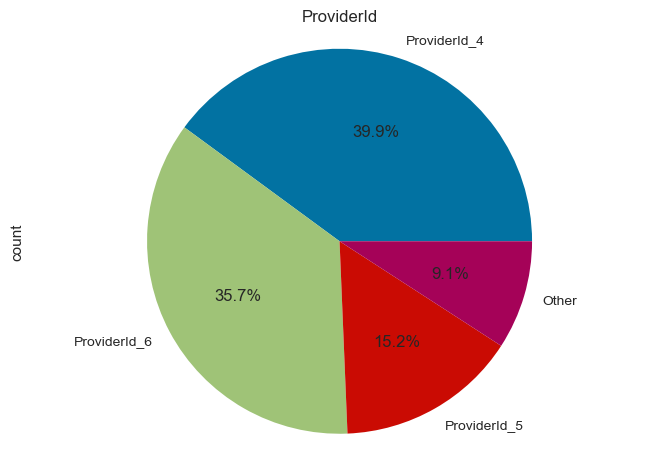

In [27]:
# Recoder la variable providerID 
frequencies_provider = df['ProviderId'].value_counts(normalize=True) * 100

# Sélectionner les provider dont la fréquence dépasse 12%
provider_above_12 = frequencies_provider[frequencies_provider > 12]

provider_list = provider_above_12.index.tolist()

def recode_provider(X):
  try:
        if 'ProviderId' in X.columns:
            X = X.copy()
            X['ProviderId'] = X['ProviderId'].apply(lambda x: x if x in provider_list else 'Other')
        return X
  except:
        print("Vérifier la liste des colonnes")

df = recode_provider(df)

df['ProviderId'].value_counts().plot(kind='pie',autopct='%1.1f%%')
plt.title('ProviderId')
plt.axis('equal')
plt.show()


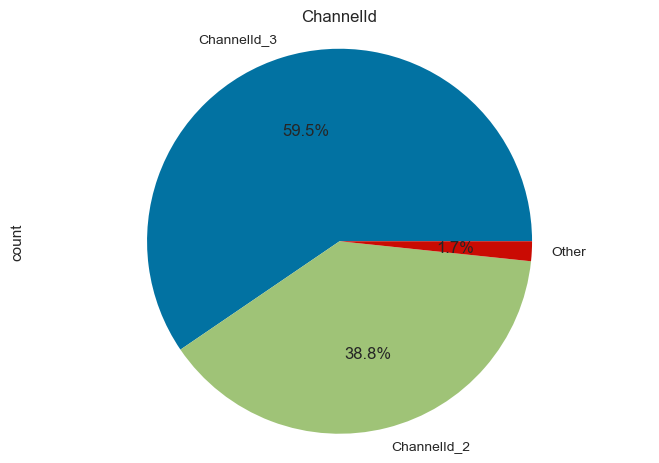

In [28]:
# Recoder la variable ChannelId

channel_list = ['ChannelId_2','ChannelId_3']
def recode_channel(X):
  try:
        if 'ChannelId' in X.columns:
            X = X.copy()
            X['ChannelId'] = X['ChannelId'].apply(lambda x: x if x in channel_list else 'Other')
        return X
  except:
        print("Vérifier la liste des colonnes")

df = recode_channel(df)

# Visualiser
df['ChannelId'].value_counts().plot(kind='pie',autopct='%1.1f%%')
plt.title('ChannelId')
plt.axis('equal')
plt.show()


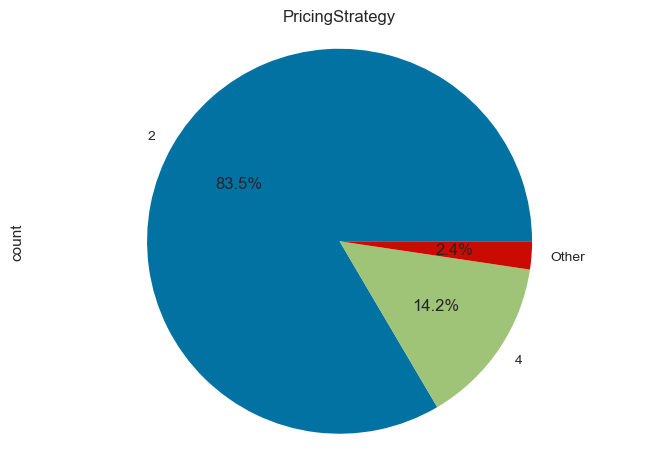

In [29]:
# Recoder la variable PricingStrategy
Pricing_list = ["2","4"]

def recode_pricing(X):
  try:
        if 'PricingStrategy' in X.columns:
            X = X.copy()
            X['PricingStrategy'] = X['PricingStrategy'].apply(lambda x: x if x in Pricing_list else 'Other')
        return X
  except:
        print("Vérifier la liste des colonnes")

df = recode_pricing(df)

# Visualiser
df['PricingStrategy'].value_counts().plot(kind='pie',autopct='%1.1f%%')
plt.title('PricingStrategy')
plt.axis('equal')
plt.show()


## Analyse univariée avec les variables numériques  

In [31]:
numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns
numeric_columns = [col for col in numeric_columns if col != 'FraudResult']
numeric_columns

['Amount',
 'Value',
 'CustomerId_abs_amount_sum',
 'SubscriptionId_transaction_count',
 'CustomerId_abs_amount_std']

In [32]:
# Initialize a figure
fig = go.Figure()

# Iterate over numeric columns in the DataFrame
for column in numeric_columns:
    fig.add_trace(go.Box(
        y=df[column],
        name=column,
        marker=dict(color='skyblue')
    ))

# Update layout with a title and axis labels
fig.update_layout(
    title='Distribution of Numeric Columns',
    yaxis_title='Values',
    xaxis_title='Numeric Columns'
)

# Show the figure
fig.show()


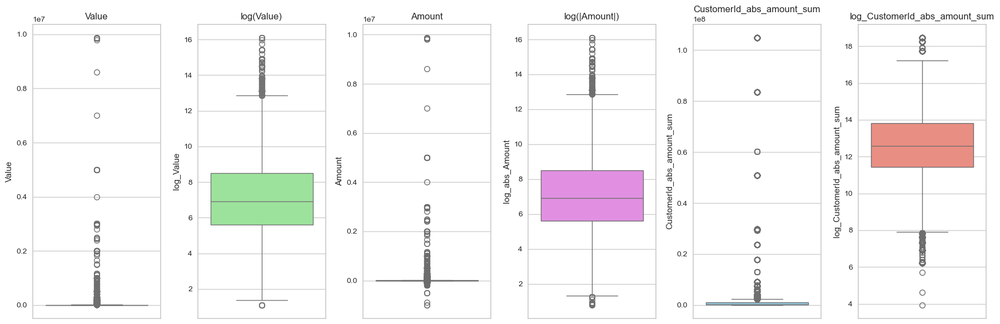

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Créer les colonnes log si elles n'existent pas
df['log_Value'] = np.log1p(df['Value'])  # log1p pour éviter log(0)
df['log_abs_Amount'] = np.log1p(df['Amount'].abs())
df['log_CustomerId_abs_amount_sum'] = np.log1p(df['CustomerId_abs_amount_sum'])

# Créer la figure
fig, axes = plt.subplots(1, 6, figsize=(18, 6))

# Tracer les boîtes
sns.boxplot(y=df['Value'], ax=axes[0], color='skyblue')
axes[0].set_title("Value")

sns.boxplot(y=df['log_Value'], ax=axes[1], color='lightgreen')
axes[1].set_title("log(Value)")

sns.boxplot(y=df['Amount'], ax=axes[2], color='salmon')
axes[2].set_title("Amount")

sns.boxplot(y=df['log_abs_Amount'], ax=axes[3], color='violet')
axes[3].set_title("log(|Amount|)")

sns.boxplot(y=df['CustomerId_abs_amount_sum'], ax=axes[4], color='skyblue')
axes[4].set_title("CustomerId_abs_amount_sum")
                                               
sns.boxplot(y=df['log_CustomerId_abs_amount_sum'], ax=axes[5], color='salmon')
axes[5].set_title("log_CustomerId_abs_amount_sum")

                                               
plt.tight_layout()
plt.show()

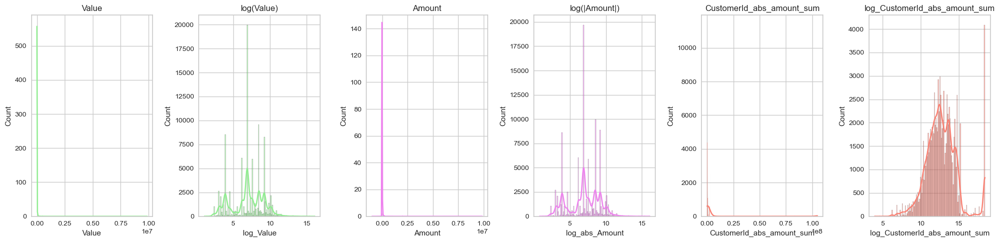

In [34]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Créer la figure avec 4 subplots en ligne
fig, axes = plt.subplots(1, 6, figsize=(20, 5))

# Tracer chaque distribution
sns.histplot(df['Value'], kde=True, color='lightgreen', ax=axes[0])
axes[0].set_title("Value")
axes[0].set_ylim(0, 590) 

sns.histplot(df['log_Value'], kde=True, color='lightgreen', ax=axes[1])
axes[1].set_title("log(Value)")

sns.histplot(df['Amount'], kde=True, color='violet', ax=axes[2])
axes[2].set_title("Amount")
axes[2].set_ylim(0, 150)  

sns.histplot(df['log_abs_Amount'], kde=True, color='violet', ax=axes[3])
axes[3].set_title("log(|Amount|)")

sns.histplot(df['CustomerId_abs_amount_sum'], kde=True, color='salmon', ax=axes[4])
axes[4].set_title("CustomerId_abs_amount_sum")

sns.histplot(df['log_CustomerId_abs_amount_sum'], kde=True, color='salmon', ax=axes[5])
axes[5].set_title("log_CustomerId_abs_amount_sum")

plt.tight_layout()
plt.show()


## Analyse bivariée avec les variables catégorielles  

In [36]:
from scipy.stats import chi2_contingency
import numpy as np
import pandas as pd

var_names = []
chi2_scores = []
p_values = []
cramer_vs = []

for var in categorical_columns:
    contingency_table = pd.crosstab(df['FraudResult'], df[var])
    chi2, p, dof, expected = chi2_contingency(contingency_table)

    # Calcul du nombre total d'observations
    n = contingency_table.values.sum()
    k, r = contingency_table.shape

    # Calcul corrigé du V de Cramér
    cramer_v = np.sqrt(chi2 / (n * (min(k - 1, r - 1))))

    # Stockage des résultats
    var_names.append(var)
    chi2_scores.append(chi2)
    p_values.append(p)
    cramer_vs.append(cramer_v)

# Résultat final sous forme de DataFrame
resultats = pd.DataFrame({
    'Variable': var_names,
    'Chi2': chi2_scores,
    'P-value': p_values,
    'Cramer V': cramer_vs
})

# Affichage des résultats
print(resultats.sort_values(by='Cramer V', ascending=False))



          Variable        Chi2        P-value  Cramer V
1        ProductId  846.638991  6.058597e-182  0.094076
0       ProviderId  778.473546  2.017141e-168  0.090209
3  PricingStrategy  339.000697   2.437440e-74  0.059529
4  TransactionType  110.810334   6.511141e-26  0.034035
2        ChannelId  107.290011   5.038138e-24  0.033490
5   TransactionDay   24.834141   3.664595e-04  0.016112
6      MomentOfDay    8.368106   1.523663e-02  0.009353


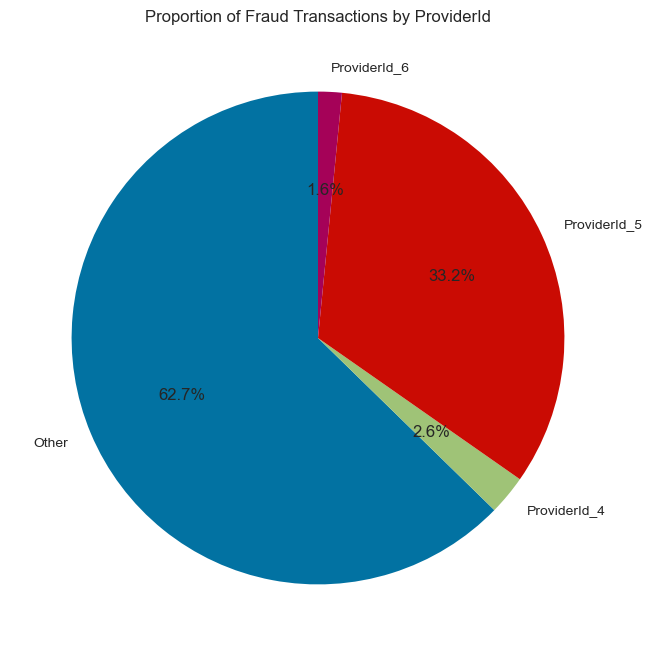

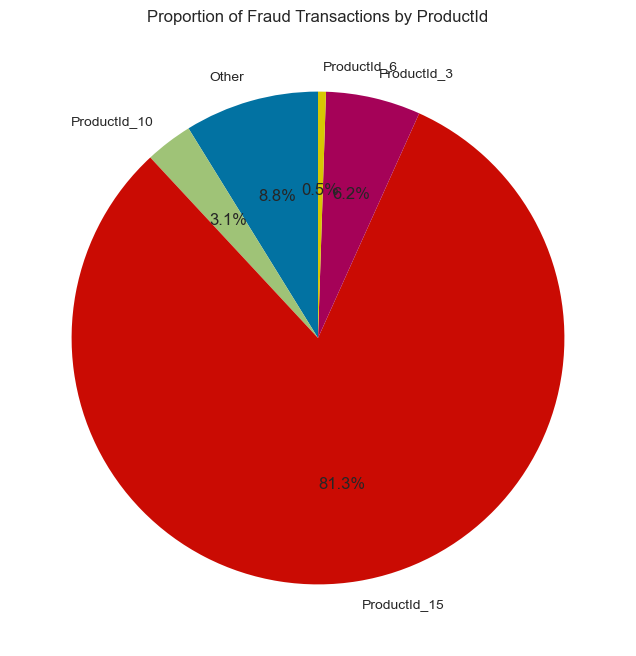

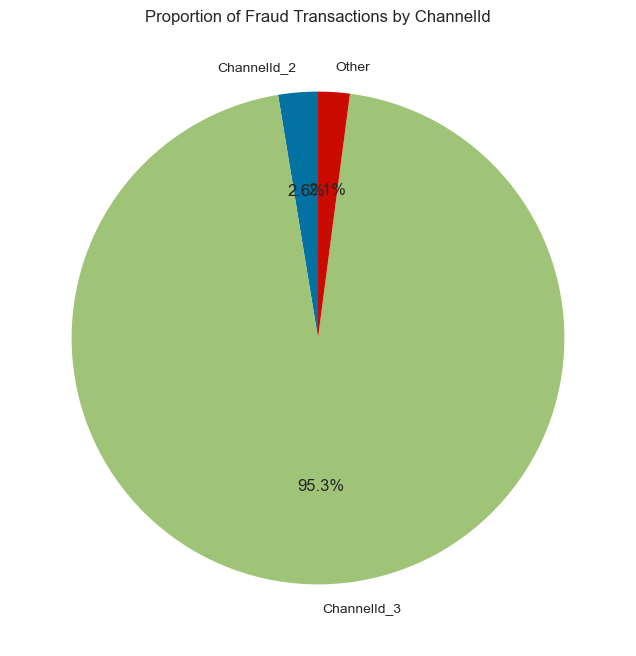

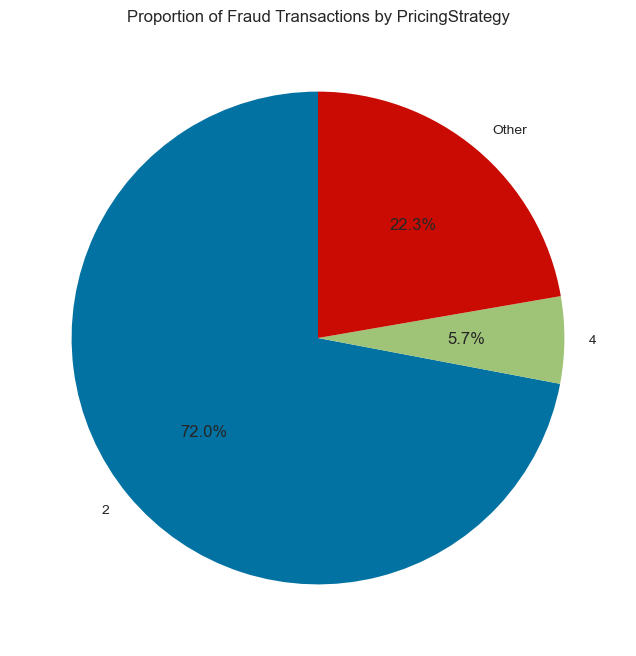

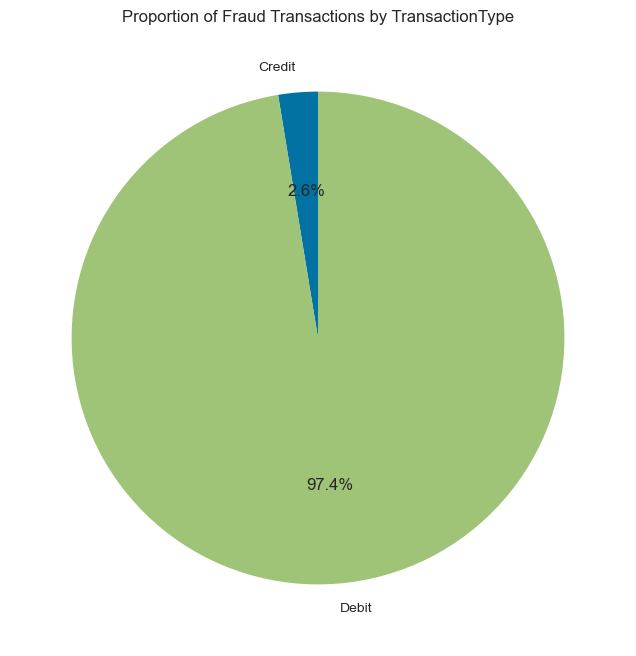

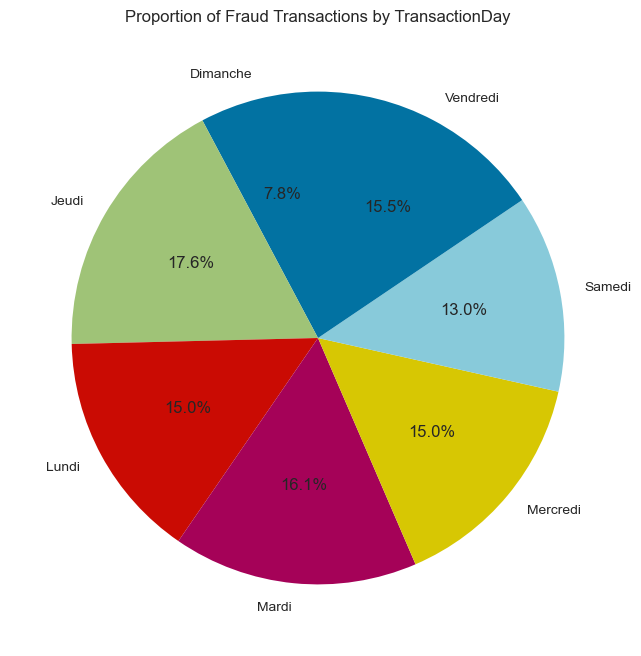

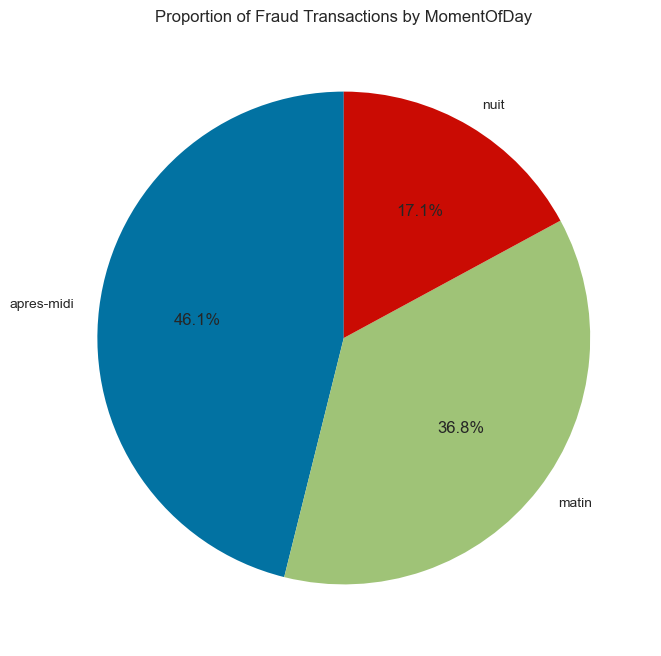

In [37]:
fraud_transactions = df[df["FraudResult"] == 1]
for col in categorical_columns:
    fraud_counts_by_columns = fraud_transactions.groupby(col).size()
    plt.figure(figsize=(8, 8))
    plt.pie(fraud_counts_by_columns, labels=fraud_counts_by_columns.index , autopct='%1.1f%%', startangle=90)
    plt.title(f'Proportion of Fraud Transactions by {col}')
    plt.show()


In [38]:
for col_name in categorical_columns:
    feature_FraudResult_counts = df.groupby([col_name, 'FraudResult']).size().unstack()
    
    fig = px.bar(feature_FraudResult_counts,
                 barmode='stack',  # Stack bars for income categories
                 title=f'Relationship between FraudResult and {col_name}',
                 labels={'value': 'Count'}
                )
    fig.show()

## Analyse bivariée avec les variables numériques 

Écart moyen pondéré (Frauduleuses) : 1666.269430051814
Écart moyen pondéré (Non Frauduleuses) : 40.193408331500265


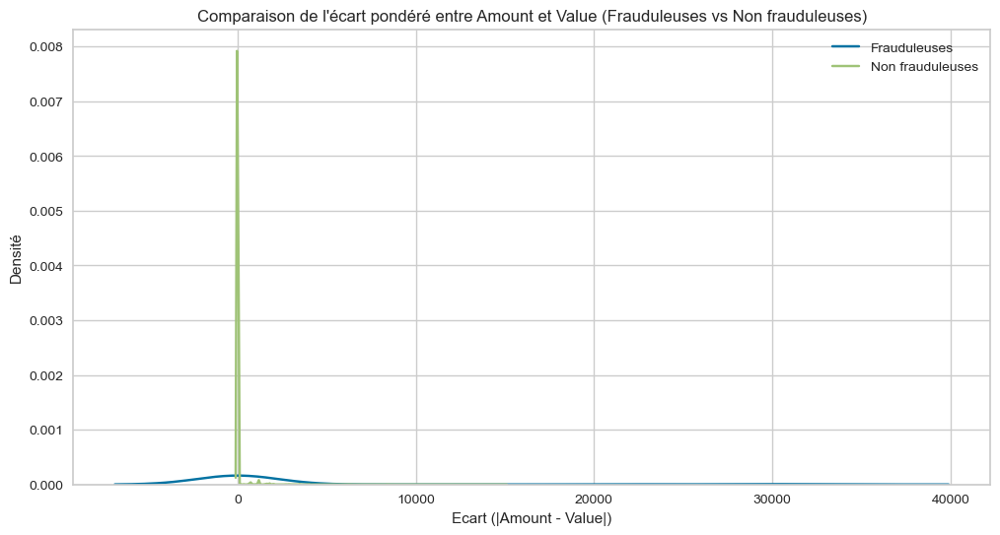

In [40]:
# Création de la colonne "Ecart" entre Amount et Value
df['Amount_Value_Ecart'] = df['Value'] - df['Amount'].abs()

poids_non_fraud = (95469 + 193) / 95469  # Poids pour la classe non frauduleuse
poids_fraud = (95469 + 193) / 193        # Poids pour la classe frauduleuse

# Ajout des poids dans le DataFrame
df['Weight'] = df['FraudResult'].apply(lambda x: poids_fraud if x == 1 else poids_non_fraud)

# Séparation des données par classe FraudResult
fraud_df = df[df['FraudResult'] == 1]
non_fraud_df = df[df['FraudResult'] == 0]

# Calcul des statistiques descriptives de l'écart avec pondération
fraud_weighted = fraud_df[['Amount_Value_Ecart', 'Weight']].apply(lambda x: x['Amount_Value_Ecart'] * x['Weight'], axis=1).sum() / fraud_df['Weight'].sum()
non_fraud_weighted = non_fraud_df[['Amount_Value_Ecart', 'Weight']].apply(lambda x: x['Amount_Value_Ecart'] * x['Weight'], axis=1).sum() / non_fraud_df['Weight'].sum()

# Affichage des résultats
print(f"Écart moyen pondéré (Frauduleuses) : {fraud_weighted}")
print(f"Écart moyen pondéré (Non Frauduleuses) : {non_fraud_weighted}")

# Comparaison graphique avec pondération
plt.figure(figsize=(12, 6))
sns.kdeplot(fraud_df['Amount_Value_Ecart'], label='Frauduleuses')
sns.kdeplot(non_fraud_df['Amount_Value_Ecart'], label='Non frauduleuses')
plt.title("Comparaison de l'écart pondéré entre Amount et Value (Frauduleuses vs Non frauduleuses)")
plt.xlabel("Ecart (|Amount - Value|)")
plt.ylabel("Densité")
plt.legend()
plt.show()
# conclusion : L'écart entre Amount et Value semble être un bon indicateur pour distinguer les transactions frauduleuses des transactions non frauduleuses
df.drop(columns="Weight", inplace=True)

In [41]:
numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns
numeric_columns = [col for col in numeric_columns if col != 'FraudResult']
numeric_columns

['Amount',
 'Value',
 'CustomerId_abs_amount_sum',
 'SubscriptionId_transaction_count',
 'CustomerId_abs_amount_std',
 'log_Value',
 'log_abs_Amount',
 'log_CustomerId_abs_amount_sum',
 'Amount_Value_Ecart']

In [42]:
from scipy import stats

var_names = []
f_stat_values_fraud = []
p_values_fraud = []
f_stat_values_non_fraud = []
p_values_non_fraud = []

for var in numeric_columns:
    # Groupes pour les transactions non frauduleuses et frauduleuses
    group1 = df[df['FraudResult'] == 0][var]  # Non-fraudulent transactions
    group2 = df[df['FraudResult'] == 1][var]  # Fraudulent transactions

    # Test ANOVA pour comparer les deux groupes (fraude et non fraude)
    f_stat, p = stats.f_oneway(group1, group2)

    # Ajouter les résultats pour chaque variable
    var_names.append(var)
    f_stat_values_fraud.append(f_stat)
    p_values_fraud.append(p)
    f_stat_values_non_fraud.append(f_stat)  # Même F-statistique pour les deux groupes
    p_values_non_fraud.append(p)           # Même p-value pour les deux groupes

# Création d'un DataFrame avec les résultats
resultats = pd.DataFrame({
    'Variable': var_names,
    'F-Statistic (Fraud vs Non-Fraud)': f_stat_values_fraud,
    'P-value (Fraud vs Non-Fraud)': p_values_fraud
})

resultats


,Variable,F-Statistic (Fraud vs Non-Fraud),P-value (Fraud vs Non-Fraud)
0,Amount,43110.703592,0.000000e+00
1,Value,45263.637610,0.000000e+00
2,CustomerId_abs_amount_sum,201.449733,1.121824e-45
3,SubscriptionId_transaction_count,101.949045,5.856702e-24
4,CustomerId_abs_amount_std,13794.259549,0.000000e+00
5,log_Value,1877.475793,0.000000e+00
6,log_abs_Amount,1882.835102,0.000000e+00
7,log_CustomerId_abs_amount_sum,551.681564,1.201010e-121
8,Amount_Value_Ecart,2455.639410,0.000000e+00


In [43]:
import scipy.stats as stats
import pandas as pd

var_names = []
ks_stat_nonfraud = []
p_values_nonfraud = []
ks_stat_fraud = []
p_values_fraud = []

for var in numeric_columns:
    # Groupe non frauduleux
    group_nonfraud = df[df['FraudResult'] == 0][var]
    group_nonfraud_std = (group_nonfraud - group_nonfraud.mean()) / group_nonfraud.std()
    ks_nonfraud = stats.kstest(group_nonfraud_std, 'norm')
    
    # Groupe frauduleux
    group_fraud = df[df['FraudResult'] == 1][var]
    group_fraud_std = (group_fraud - group_fraud.mean()) / group_fraud.std()
    ks_fraud = stats.kstest(group_fraud_std, 'norm')
    
    # Stocker les résultats
    var_names.append(var)
    ks_stat_nonfraud.append(ks_nonfraud.statistic)
    p_values_nonfraud.append(ks_nonfraud.pvalue)
    ks_stat_fraud.append(ks_fraud.statistic)
    p_values_fraud.append(ks_fraud.pvalue)

# Créer le DataFrame des résultats
resultats = pd.DataFrame({
    'Variable': var_names,
    'KS Stat (Non Fraude)': ks_stat_nonfraud,
    'P-value (Non Fraude)': p_values_nonfraud,
    'KS Stat (Fraude)': ks_stat_fraud,
    'P-value (Fraude)': p_values_fraud
})

resultats


,Variable,KS Stat (Non Fraude),P-value (Non Fraude),KS Stat (Fraude),P-value (Fraude)
0,Amount,0.374611,0.0,0.294872,2.287785e-15
1,Value,0.432878,0.0,0.300700,5.647188e-16
2,CustomerId_abs_amount_sum,0.472964,0.0,0.238474,3.840015e-10
3,SubscriptionId_transaction_count,0.362110,0.0,0.481315,1.179559e-41
4,CustomerId_abs_amount_std,0.417989,0.0,0.194475,7.195051e-07
5,log_Value,0.150131,0.0,0.248717,5.277851e-11
6,log_abs_Amount,0.150591,0.0,0.249627,4.406389e-11
7,log_CustomerId_abs_amount_sum,0.067177,0.0,0.144761,5.413064e-04
8,Amount_Value_Ecart,0.521604,0.0,0.537871,9.388479e-53


In [44]:
# Certaines colonnes n’apportent plus d'information utile au modèle
cols_to_drop = ['Amount', 'log_Value', 'log_abs_Amount','CustomerId_abs_amount_sum']
df.drop(columns=cols_to_drop, inplace=True)

In [45]:
numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns
numeric_columns = [col for col in numeric_columns if col != 'FraudResult']
numeric_columns


['Value',
 'SubscriptionId_transaction_count',
 'CustomerId_abs_amount_std',
 'log_CustomerId_abs_amount_sum',
 'Amount_Value_Ecart']

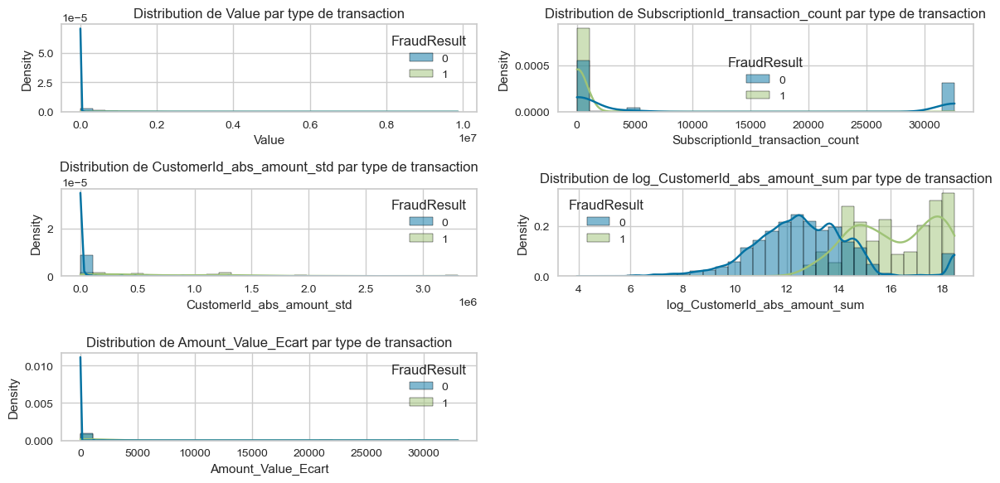

In [46]:
import seaborn as sns
import matplotlib.pyplot as plt


# Créer une figure pour afficher les graphiques
plt.figure(figsize=(12, 6))

# Boucle sur les variables à visualiser
for i, var in enumerate(numeric_columns):
    plt.subplot(3, 2, i + 1)
    
    # Tracer les histogrammes et les courbes de densité
    sns.histplot(data=df, x=var, hue="FraudResult", kde=True, stat="density", common_norm=False, bins=30)
    
    # Ajouter des labels et un titre
    plt.title(f'Distribution de {var} par type de transaction')
    plt.xlabel(var)
    plt.ylabel('Density')
    
plt.tight_layout()
plt.show()


In [47]:

for column in numeric_columns:
    fig = px.box(
        data_frame=df,
        x='FraudResult',  
        y=column,
        title=f"Distribution de {column} par FraudResult",
        labels={'FraudResult': 'Résultat', column: column}
    )
    fig.show()


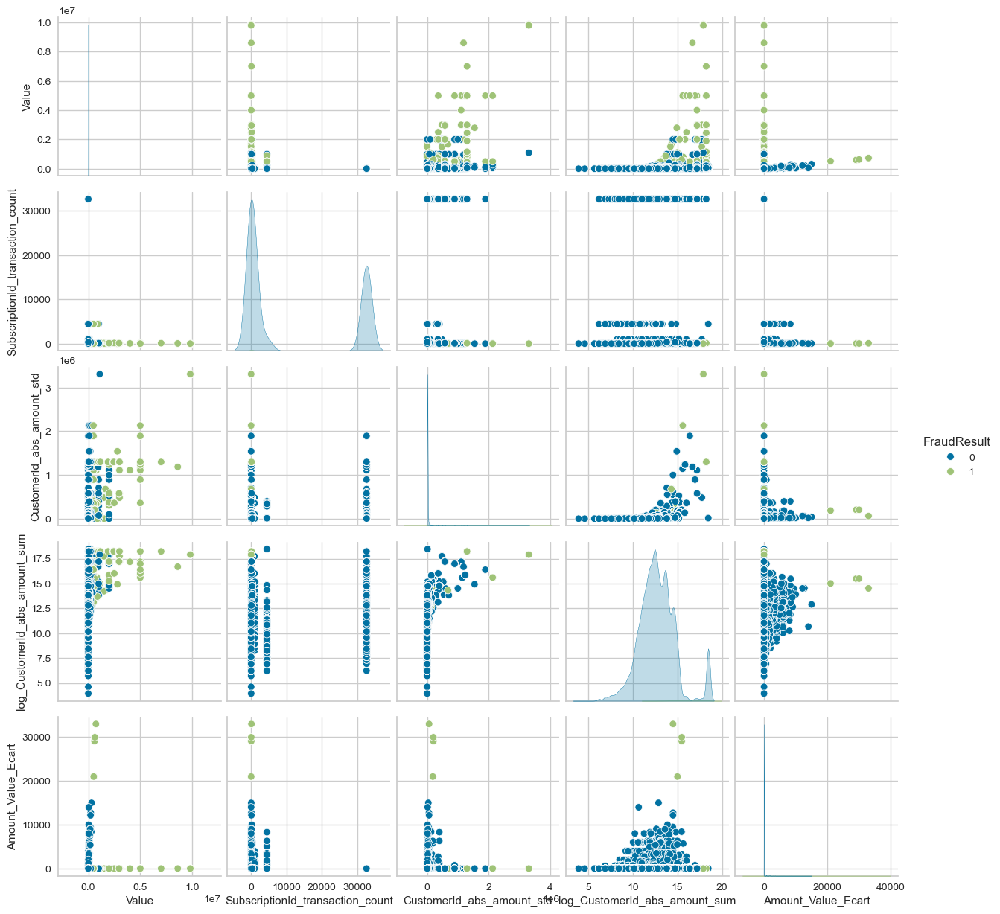

In [48]:
# Combiner 'numeric_columns' et 'FraudResult' dans une seule liste
columns_to_select = numeric_columns + ['FraudResult']

# Utiliser la liste résultante pour sélectionner les colonnes et générer le pairplot
sns.pairplot(df[columns_to_select], hue="FraudResult", corner=False)


## Corrélation

In [50]:
correlation = df[numeric_columns].corr(method="pearson")

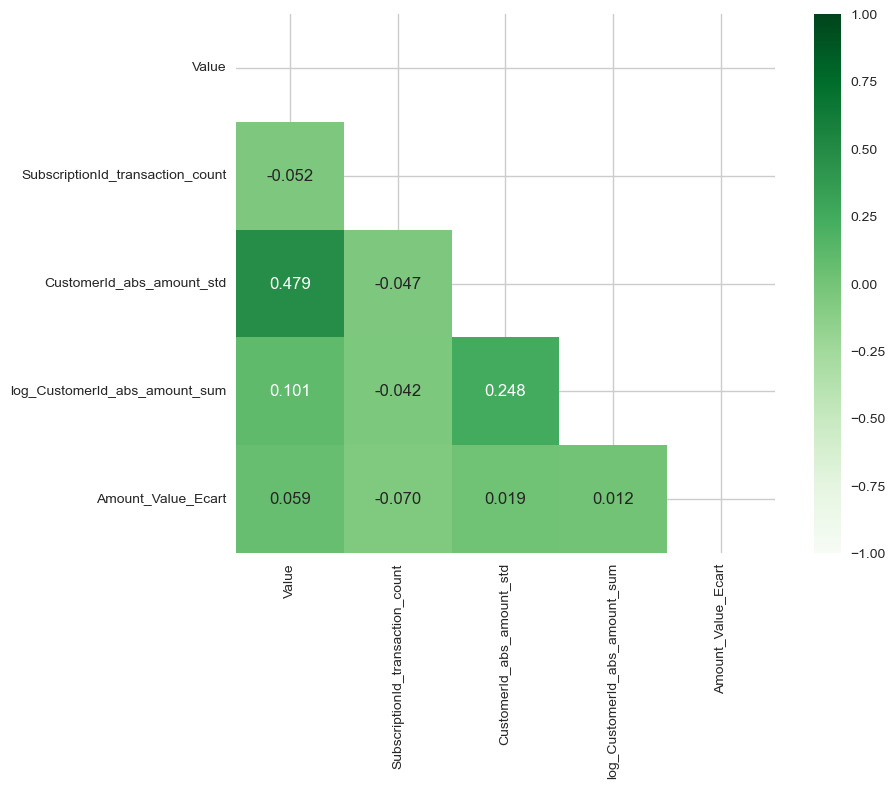

In [51]:
# correlation plot
plt.figure(figsize=(10, 7))
corr = df[numeric_columns].corr(method="pearson")
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True

sns.heatmap(corr, cmap='Greens', annot=True, square=True,
            fmt='.3f',
            mask=mask,
            cbar=True, vmin=-1, vmax=1);

# Modeling

## Régression logistique

### baseline

In [55]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as ImbPipeline
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd

# ----------------------------
# 1. Séparation des variables
# ----------------------------
X = df.drop('FraudResult', axis=1)
y = df['FraudResult']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# ----------------------------
# 2. Prétraitement
# ----------------------------
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numeric_columns),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
])

# ----------------------------
# 0. Baseline (modèle par défaut)
# ----------------------------
print("📌 Baseline : Régression Logistique sans tuning ni sampling")

baseline_pipeline = ImbPipeline([
    ('preproc', preprocessor),
    ('clf', LogisticRegression(random_state=42))
])

baseline_pipeline.fit(X_train, y_train)
y_pred_baseline = baseline_pipeline.predict(X_val)
y_proba_baseline = baseline_pipeline.predict_proba(X_val)[:, 1]

print("➡️ Performance du modèle baseline :")
print(f"Accuracy  : {accuracy_score(y_val, y_pred_baseline):.4f}")
print(f"Précision : {precision_score(y_val, y_pred_baseline, zero_division=0):.4f}")
print(f"Rappel    : {recall_score(y_val, y_pred_baseline):.4f}")
print(f"F1-score  : {f1_score(y_val, y_pred_baseline):.4f}")
print(f"ROC AUC   : {roc_auc_score(y_val, y_proba_baseline):.4f}")
# ----------------------------
# Affichage des hyperparamètres par défaut
# ----------------------------
print("\n📋 Hyperparamètres par défaut de la Régression Logistique :")
for param, val in baseline_pipeline.named_steps['clf'].get_params().items():
    print(f"{param}: {val}")


📌 Baseline : Régression Logistique sans tuning ni sampling
➡️ Performance du modèle baseline :
Accuracy  : 0.9982
Précision : 0.6000
Rappel    : 0.3621
F1-score  : 0.4516
ROC AUC   : 0.9943

📋 Hyperparamètres par défaut de la Régression Logistique :
C: 1.0
class_weight: None
dual: False
fit_intercept: True
intercept_scaling: 1
l1_ratio: None
max_iter: 100
multi_class: deprecated
n_jobs: None
penalty: l2
random_state: 42
solver: lbfgs
tol: 0.0001
verbose: 0
warm_start: False


### Tuning and sampling with regression logistique

In [57]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd

# ----------------------------
# 1. Séparation des variables
# ----------------------------
X = df.drop('FraudResult', axis=1)
y = df['FraudResult']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# ----------------------------
# 2. Prétraitement dans un transformer unique
# ----------------------------
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numeric_columns),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
])

# ----------------------------
# 3. Paramètres de recherche pour RandomForest et sampling
# ----------------------------
# Paramètres de base du classifieur
param_grid = {
    'clf__penalty': ['l2'],
    'clf__C': [0.1, 10],
    'clf__solver': ['lbfgs'],
    'clf__max_iter': [6000]
}

# Paramètres avec suréchantillonnage SMOTE
param_grid_smote = param_grid.copy()
param_grid_smote.update({
    'smote__sampling_strategy': [0.25, 0.5]
})

# Paramètres avec sous-échantillonnage
param_grid_under = param_grid.copy()
param_grid_under.update({
    'under__sampling_strategy': [0.25, 0.5]
})

# ----------------------------
# 4. Pipelines avec différentes méthodes
# ----------------------------
pipelines = {
    "Original": ImbPipeline([
        ('preproc', preprocessor),
        ('clf', LogisticRegression())
    ]),
    "SMOTE": ImbPipeline([
        ('preproc', preprocessor),
        ('smote', SMOTE(random_state=42)),
        ('clf', LogisticRegression())
    ]),
    "UnderSampling": ImbPipeline([
        ('preproc', preprocessor),
        ('under', RandomUnderSampler(random_state=42)),
        ('clf', LogisticRegression())
    ]),
    "Pondération": ImbPipeline([
        ('preproc', preprocessor),
        ('clf', LogisticRegression(class_weight='balanced'))
    ])
}

# ----------------------------
# 5. Entraînement et évaluation
# ----------------------------
resultats = []


for methode, pipeline in pipelines.items():
    print(f"\n🔍 Méthode : {methode}")

    if "SMOTE" in methode:
        tuned_parameters = param_grid_smote
    elif "UnderSampling" in methode:
        tuned_parameters = param_grid_under
    else:
        tuned_parameters = param_grid
    
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)    
    grid = GridSearchCV(pipeline, tuned_parameters, cv=cv, scoring='f1', n_jobs=-1, error_score='raise')
    grid.fit(X_train, y_train)

    
    best_model = grid.best_estimator_
    y_pred = best_model.predict(X_val)
    y_proba = best_model.predict_proba(X_val)[:, 1]

    resultats.append({
        'Méthode': methode,
        'Accuracy': accuracy_score(y_val, y_pred),
        'Précision': precision_score(y_val, y_pred, zero_division=0),
        'Rappel': recall_score(y_val, y_pred),
        'F1-score': f1_score(y_val, y_pred),
        'ROC AUC': roc_auc_score(y_val, y_proba),
        'Best Params': grid.best_params_
    })

# ----------------------------
# 6. Résumé des résultats
# ----------------------------
df_resultats = pd.DataFrame(resultats)
df_resultats = df_resultats.sort_values(by='F1-score', ascending=False).reset_index(drop=True)

print("\n📊 Résumé des performances pour regression logistique:")
print(df_resultats)



🔍 Méthode : Original

🔍 Méthode : SMOTE

🔍 Méthode : UnderSampling

🔍 Méthode : Pondération

📊 Résumé des performances pour regression logistique:
         Méthode  Accuracy  Précision    Rappel  F1-score   ROC AUC  \
0  UnderSampling  0.997352   0.429688  0.948276  0.591398  0.998690   
1          SMOTE  0.995923   0.325444  0.948276  0.484581  0.998113   
2       Original  0.998188   0.583333  0.362069  0.446809  0.997757   
3    Pondération  0.991254   0.181518  0.948276  0.304709  0.997635   

                                         Best Params  
0  {'clf__C': 0.1, 'clf__max_iter': 6000, 'clf__p...  
1  {'clf__C': 0.1, 'clf__max_iter': 6000, 'clf__p...  
2  {'clf__C': 0.1, 'clf__max_iter': 6000, 'clf__p...  
3  {'clf__C': 0.1, 'clf__max_iter': 6000, 'clf__p...  


## récupérer le pipeline optimal pour regression logistique

In [59]:
# Recréer le pipeline avec les meilleurs paramètres
from sklearn.linear_model import LogisticRegression
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.under_sampling import RandomUnderSampler

# Meilleurs hyperparamètres
best_params = df_resultats[df_resultats['Méthode'] == 'UnderSampling']['Best Params'].values[0]
# Reconstruire le pipeline final
best_pipeline_regressin_logistique = ImbPipeline([
    ('preproc', preprocessor),
    ('under', RandomUnderSampler(sampling_strategy=best_params['under__sampling_strategy'], random_state=42)),
    ('clf', LogisticRegression(
        penalty=best_params['clf__penalty'],
        C=best_params['clf__C'],
        solver=best_params['clf__solver'],
        max_iter=best_params['clf__max_iter']
    ))
])


# Entraîner le pipeline final
print("best hyperam", best_params)
best_pipeline_regressin_logistique.fit(X_train, y_train)


best hyperam {'clf__C': 0.1, 'clf__max_iter': 6000, 'clf__penalty': 'l2', 'clf__solver': 'lbfgs', 'under__sampling_strategy': 0.25}


Pipeline(steps=[('preproc',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['Value',
                                                   'SubscriptionId_transaction_count',
                                                   'CustomerId_abs_amount_std',
                                                   'log_CustomerId_abs_amount_sum',
                                                   'Amount_Value_Ecart']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  Index(['ProviderId', 'ProductId', 'ChannelId', 'PricingStrategy',
       'TransactionType', 'TransactionDay', 'MomentOfDay'],
      dtype='object'))])),
                ('under',
                 RandomUnderSampler(random_state=42, sampling_strategy=0.25)),
                ('clf', LogisticRegression(C=0.1, max_iter=6000))])

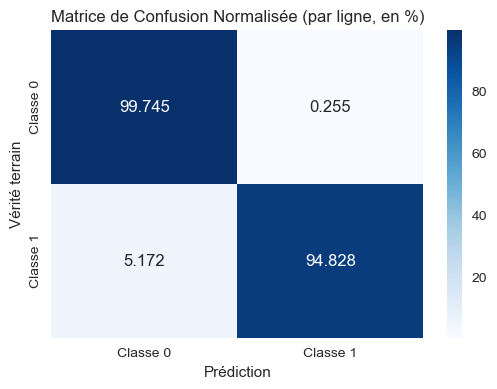

Rapport de classification :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     28641
           1       0.43      0.95      0.59        58

    accuracy                           1.00     28699
   macro avg       0.71      0.97      0.80     28699
weighted avg       1.00      1.00      1.00     28699



In [60]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Prédictions du modèle
y_pred = best_pipeline_regressin_logistique.predict(X_val)

# 2. Matrice de confusion normalisée par ligne (pourcentage par classe réelle)
conf_matrix_normalized = confusion_matrix(y_val, y_pred, normalize='true') * 100  # en %

# 3. Affichage de la matrice de confusion normalisée
plt.figure(figsize=(6, 4))
sns.heatmap(conf_matrix_normalized, annot=True, fmt='.3f', cmap='Blues',
            xticklabels=['Classe 0', 'Classe 1'],
            yticklabels=['Classe 0', 'Classe 1'])
plt.title('Matrice de Confusion Normalisée (par ligne, en %)')
plt.xlabel('Prédiction')
plt.ylabel('Vérité terrain')
plt.show()

# 4. Affichage du rapport de classification
print("Rapport de classification :\n", classification_report(y_val, y_pred))


In [61]:
import dill

# Enregistrer le meilleur modèle avec dill
with open('best_Regression_logistique.dill', 'wb') as f:
    dill.dump(best_pipeline_regressin_logistique, f)
    
# Charger le modèle avec dill
with open('best_Regression_logistique.dill', 'rb') as f:
    loaded_model = dill.load(f)
# Effectuer une prédiction pour tester le modèle chargé
y_pred = loaded_model.predict(X_val)
print(y_pred)


[0 0 0 ... 0 0 0]


## KNN

## Baseline

In [64]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as ImbPipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd

# ----------------------------
# 1. Séparation des variables
# ----------------------------
X = df.drop('FraudResult', axis=1)
y = df['FraudResult']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# ----------------------------
# 2. Prétraitement
# ----------------------------
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numeric_columns),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
])

# ----------------------------
# 0. Baseline (modèle par défaut)
# ----------------------------
print("📌 Baseline : K-Nearest Neighbors sans tuning ni sampling")

baseline_pipeline = ImbPipeline([
    ('preproc', preprocessor),
    ('clf', KNeighborsClassifier())
])

baseline_pipeline.fit(X_train, y_train)
y_pred_baseline = baseline_pipeline.predict(X_val)
y_proba_baseline = baseline_pipeline.predict_proba(X_val)[:, 1]

print("➡️ Performance du modèle baseline :")
print(f"Accuracy  : {accuracy_score(y_val, y_pred_baseline):.4f}")
print(f"Précision : {precision_score(y_val, y_pred_baseline, zero_division=0):.4f}")
print(f"Rappel    : {recall_score(y_val, y_pred_baseline):.4f}")
print(f"F1-score  : {f1_score(y_val, y_pred_baseline):.4f}")
print(f"ROC AUC   : {roc_auc_score(y_val, y_proba_baseline):.4f}")

# ----------------------------
# Affichage des hyperparamètres par défaut
# ----------------------------
print("\n📋 Hyperparamètres par défaut de K-Nearest Neighbors :")
for param, val in baseline_pipeline.named_steps['clf'].get_params().items():
    print(f"{param}: {val}")


📌 Baseline : K-Nearest Neighbors sans tuning ni sampling
➡️ Performance du modèle baseline :
Accuracy  : 0.9991
Précision : 0.8667
Rappel    : 0.6724
F1-score  : 0.7573
ROC AUC   : 0.9567

📋 Hyperparamètres par défaut de K-Nearest Neighbors :
algorithm: auto
leaf_size: 30
metric: minkowski
metric_params: None
n_jobs: None
n_neighbors: 5
p: 2
weights: uniform


### Tuning and sampling with KNN

In [66]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd

# ----------------------------
# 1. Séparation des variables
# ----------------------------
X = df.drop('FraudResult', axis=1)
y = df['FraudResult']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# ----------------------------
# 2. Prétraitement dans un transformer unique
# ----------------------------
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numeric_columns),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
])

# ----------------------------
# 3. Paramètres de recherche pour KNN et sampling
# ----------------------------
# Paramètres de base du classifieur KNN
param_grid = {
    'clf__n_neighbors': [3, 10],
    'clf__metric': ['minkowski', 'euclidean'],
    'clf__weights': ['uniform', 'distance'],
}

# Paramètres avec suréchantillonnage SMOTE
param_grid_smote = param_grid.copy()
param_grid_smote.update({
    'smote__sampling_strategy': [0.25, 0.5]
})

# Paramètres avec sous-échantillonnage
param_grid_under = param_grid.copy()
param_grid_under.update({
    'under__sampling_strategy': [0.25, 0.5]
})

# ----------------------------
# 4. Pipelines avec différentes méthodes
# ----------------------------
pipelines = {
    "Original": ImbPipeline([
        ('preproc', preprocessor),
        ('clf', KNeighborsClassifier())
    ]),
    "SMOTE": ImbPipeline([
        ('preproc', preprocessor),
        ('smote', SMOTE(random_state=42)),
        ('clf', KNeighborsClassifier())
    ]),
    "UnderSampling": ImbPipeline([
        ('preproc', preprocessor),
        ('under', RandomUnderSampler(random_state=42)),
        ('clf', KNeighborsClassifier())
    ]),
    "Pondération": ImbPipeline([
        ('preproc', preprocessor),
        ('clf', KNeighborsClassifier(weights='uniform'))  # "uniform" pour l'équilibre des poids
    ])
}

# ----------------------------
# 5. Entraînement et évaluation
# ----------------------------
resultats_knn = []

for methode, pipeline in pipelines.items():
    print(f"\n🔍 Méthode : {methode}")

    if "SMOTE" in methode:
        tuned_parameters = param_grid_smote
    elif "UnderSampling" in methode:
        tuned_parameters = param_grid_under
    else:
        tuned_parameters = param_grid
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)    
    grid = GridSearchCV(pipeline, tuned_parameters, cv=cv, scoring='f1', n_jobs=-1, error_score='raise')
    grid.fit(X_train, y_train)
    best_model = grid.best_estimator_
    y_pred = best_model.predict(X_val)
    y_proba = best_model.predict_proba(X_val)[:, 1]

    resultats_knn.append({
        'Méthode': methode,
        'Accuracy': accuracy_score(y_val, y_pred),
        'Précision': precision_score(y_val, y_pred, zero_division=0),
        'Rappel': recall_score(y_val, y_pred),
        'F1-score': f1_score(y_val, y_pred),
        'ROC AUC': roc_auc_score(y_val, y_proba),
        'Best Params': grid.best_params_
    })

# ----------------------------
# 6. Résumé des résultats
# ----------------------------
df_resultats_knn = pd.DataFrame(resultats_knn)
df_resultats_knn = df_resultats_knn.sort_values(by='F1-score', ascending=False).reset_index(drop=True)

print("\n📊 Résumé des performances pour K-Nearest Neighbors :")
print(df_resultats_knn)



🔍 Méthode : Original

🔍 Méthode : SMOTE

🔍 Méthode : UnderSampling

🔍 Méthode : Pondération

📊 Résumé des performances pour K-Nearest Neighbors :
         Méthode  Accuracy  Précision    Rappel  F1-score   ROC AUC  \
0          SMOTE  0.999059   0.746032  0.810345  0.776860  0.965245   
1       Original  0.999094   0.863636  0.655172  0.745098  0.982481   
2    Pondération  0.999094   0.863636  0.655172  0.745098  0.982481   
3  UnderSampling  0.993519   0.233333  0.965517  0.375839  0.980774   

                                         Best Params  
0  {'clf__metric': 'minkowski', 'clf__n_neighbors...  
1  {'clf__metric': 'minkowski', 'clf__n_neighbors...  
2  {'clf__metric': 'minkowski', 'clf__n_neighbors...  
3  {'clf__metric': 'minkowski', 'clf__n_neighbors...  


## récupérer le pipeline optimal pour KNN

In [68]:
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier

# Meilleurs hyperparamètres obtenus par SMOTE
best_params = df_resultats_knn[df_resultats_knn['Méthode'] == 'SMOTE']['Best Params'].values[0]
# Reconstruire le pipeline final avec SMOTE et KNN
best_pipeline_KNN= ImbPipeline([
    ('preproc', preprocessor),
    ('smote', SMOTE(sampling_strategy=best_params['smote__sampling_strategy'], random_state=42)),
    ('clf', KNeighborsClassifier(
        n_neighbors=best_params['clf__n_neighbors'],
        weights=best_params['clf__weights']

    ))
])
print("best hyperparam", best_params)
# Entraîner le pipeline final
best_pipeline_KNN.fit(X_train, y_train)


best hyperparam {'clf__metric': 'minkowski', 'clf__n_neighbors': 3, 'clf__weights': 'distance', 'smote__sampling_strategy': 0.25}


Pipeline(steps=[('preproc',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['Value',
                                                   'SubscriptionId_transaction_count',
                                                   'CustomerId_abs_amount_std',
                                                   'log_CustomerId_abs_amount_sum',
                                                   'Amount_Value_Ecart']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  Index(['ProviderId', 'ProductId', 'ChannelId', 'PricingStrategy',
       'TransactionType', 'TransactionDay', 'MomentOfDay'],
      dtype='object'))])),
                ('smote', SMOTE(random_state=42, sampling_strategy=0.25)),
                ('clf',
                 KNeighborsClassifier(n_neighbors=3, weights='distance'))])

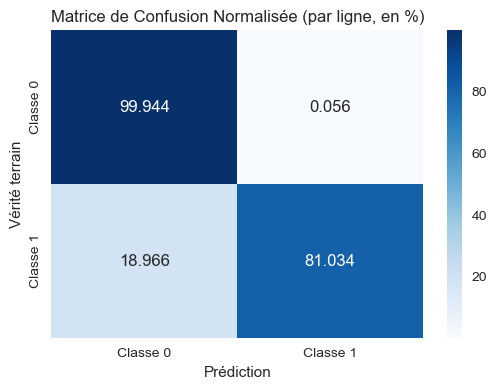

Rapport de classification :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     28641
           1       0.75      0.81      0.78        58

    accuracy                           1.00     28699
   macro avg       0.87      0.90      0.89     28699
weighted avg       1.00      1.00      1.00     28699



In [69]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# 1. Prédictions du modèle
y_pred = best_pipeline_KNN.predict(X_val)

# 2. Matrice de confusion normalisée par ligne (pourcentage par classe réelle)
conf_matrix_normalized = confusion_matrix(y_val, y_pred, normalize='true') * 100  # en %

# 3. Affichage de la matrice de confusion en pourcentage (ligne)
plt.figure(figsize=(6, 4))
sns.heatmap(conf_matrix_normalized, annot=True, fmt='.3f', cmap='Blues',
            xticklabels=['Classe 0', 'Classe 1'],
            yticklabels=['Classe 0', 'Classe 1'])
plt.title('Matrice de Confusion Normalisée (par ligne, en %)')
plt.xlabel('Prédiction')
plt.ylabel('Vérité terrain')
plt.show()

# 4. Rapport de classification
print("Rapport de classification :\n", classification_report(y_val, y_pred))



In [70]:
import dill

# Enregistrer le meilleur modèle avec dill
with open('best_KNN.dill', 'wb') as f:
    dill.dump(best_pipeline_KNN, f)
    
# Charger le modèle avec dill
with open('best_KNN.dill', 'rb') as f:
    loaded_model = dill.load(f)
# Effectuer une prédiction pour tester le modèle chargé
y_pred = loaded_model.predict(X_val)
print(y_pred)


[0 0 0 ... 0 0 0]


# Arbre de decision

## baseline

In [73]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as ImbPipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd

# ----------------------------
# 1. Séparation des variables
# ----------------------------
X = df.drop('FraudResult', axis=1)
y = df['FraudResult']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# ----------------------------
# 2. Prétraitement
# ----------------------------
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numeric_columns),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
])

# ----------------------------
# 0. Baseline (modèle par défaut)
# ----------------------------
print("📌 Baseline : Decision Tree sans tuning ni sampling")

baseline_pipeline = ImbPipeline([
    ('preproc', preprocessor),
    ('clf', DecisionTreeClassifier(random_state=42))
])

baseline_pipeline.fit(X_train, y_train)
y_pred_baseline = baseline_pipeline.predict(X_val)
y_proba_baseline = baseline_pipeline.predict_proba(X_val)[:, 1]

print("➡️ Performance du modèle baseline :")
print(f"Accuracy  : {accuracy_score(y_val, y_pred_baseline):.4f}")
print(f"Précision : {precision_score(y_val, y_pred_baseline, zero_division=0):.4f}")
print(f"Rappel    : {recall_score(y_val, y_pred_baseline):.4f}")
print(f"F1-score  : {f1_score(y_val, y_pred_baseline):.4f}")
print(f"ROC AUC   : {roc_auc_score(y_val, y_proba_baseline):.4f}")

# ----------------------------
# Affichage des hyperparamètres par défaut
# ----------------------------
print("\n📋 Hyperparamètres par défaut de Decision Tree :")
for param, val in baseline_pipeline.named_steps['clf'].get_params().items():
    print(f"{param}: {val}")


📌 Baseline : Decision Tree sans tuning ni sampling
➡️ Performance du modèle baseline :
Accuracy  : 0.9995
Précision : 0.8909
Rappel    : 0.8448
F1-score  : 0.8673
ROC AUC   : 0.9309

📋 Hyperparamètres par défaut de Decision Tree :
ccp_alpha: 0.0
class_weight: None
criterion: gini
max_depth: None
max_features: None
max_leaf_nodes: None
min_impurity_decrease: 0.0
min_samples_leaf: 1
min_samples_split: 2
min_weight_fraction_leaf: 0.0
monotonic_cst: None
random_state: 42
splitter: best


### Tuning and sampling with Arbre de decision

In [75]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd

# ----------------------------
# 1. Séparation des variables
# ----------------------------
X = df.drop('FraudResult', axis=1)
y = df['FraudResult']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# ----------------------------
# 2. Prétraitement dans un transformer unique
# ----------------------------
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numeric_columns),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
])

# ----------------------------
# 3. Paramètres de recherche pour Decision Tree
# ----------------------------
param_grid = {
    'clf__criterion': ['gini', 'entropy'],  # Critère de décision
    'clf__max_depth': [5, 10],  # Profondeur maximale de l'arbre
    'clf__min_samples_split': [4, 8],  # Nombre minimal d'échantillons pour diviser un noeud
    'clf__min_samples_leaf': [3, 7],  # Nombre minimal d'échantillons dans une feuille
    'clf__max_features': [None, 'sqrt'],  # Nombre maximal de caractéristiques à considérer
    'clf__random_state': [42]  # Fixation de l'aléa pour reproductibilité
}

# Paramètres avec suréchantillonnage SMOTE
param_grid_smote = param_grid.copy()
param_grid_smote.update({
    'smote__sampling_strategy': [0.25, 0.5]
})

# Paramètres avec sous-échantillonnage
param_grid_under = param_grid.copy()
param_grid_under.update({
    'under__sampling_strategy': [0.25, 0.5]
})


# ----------------------------
# 4. Définition des pipelines imbriqués
# ----------------------------
pipelines = {
    "Original": ImbPipeline([
        ('preproc', preprocessor),
        ('clf', DecisionTreeClassifier(random_state=42))
    ]),
    "SMOTE": ImbPipeline([
        ('preproc', preprocessor),
        ('smote', SMOTE(random_state=42)),
        ('clf', DecisionTreeClassifier(random_state=42))
    ]),
    "UnderSampling": ImbPipeline([
        ('preproc', preprocessor),
        ('under', RandomUnderSampler(random_state=42)),
        ('clf', DecisionTreeClassifier(random_state=42))
    ]),
    "Pondération": ImbPipeline([
        ('preproc', preprocessor),
        ('clf', DecisionTreeClassifier(random_state=42, class_weight='balanced'))  # Pondération des classes
    ])
}

# ----------------------------
# 5. Boucle d’entraînement et évaluation
# ----------------------------
resultats = []

for methode, pipeline in pipelines.items():
    print(f"\n🔍 Méthode : {methode}")

    if "SMOTE" in methode:
        tuned_parameters = param_grid_smote
    elif "UnderSampling" in methode:
        tuned_parameters = param_grid_under
    else:
        tuned_parameters = param_grid
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)    
    grid = GridSearchCV(pipeline, tuned_parameters, cv=cv, scoring='f1', n_jobs=-1, error_score='raise')
    grid.fit(X_train, y_train)

    best_model = grid.best_estimator_
    y_pred = best_model.predict(X_val)
    y_proba = best_model.predict_proba(X_val)[:, 1]  # Probabilités pour la classe 1

    resultats.append({
        'Méthode': methode,
        'Accuracy': accuracy_score(y_val, y_pred),
        'Précision': precision_score(y_val, y_pred, zero_division=0),
        'Rappel': recall_score(y_val, y_pred),
        'F1-score': f1_score(y_val, y_pred),
        'ROC AUC': roc_auc_score(y_val, y_proba),
        'Best Params': grid.best_params_
    })

# ----------------------------
# 6. Résumé
# ----------------------------
df_resultats = pd.DataFrame(resultats)
df_resultats = df_resultats.sort_values(by='F1-score', ascending=False).reset_index(drop=True)

print("\n📊 Résumé des performances :")
print(df_resultats)



🔍 Méthode : Original

🔍 Méthode : SMOTE

🔍 Méthode : UnderSampling

🔍 Méthode : Pondération

📊 Résumé des performances :
         Méthode  Accuracy  Précision    Rappel  F1-score   ROC AUC  \
0       Original  0.999686   0.980392  0.862069  0.917431  0.965447   
1    Pondération  0.999617   0.898305  0.913793  0.905983  0.956879   
2          SMOTE  0.999373   0.803030  0.913793  0.854839  0.973979   
3  UnderSampling  0.991289   0.186275  0.982759  0.313187  0.988809   

                                         Best Params  
0  {'clf__criterion': 'entropy', 'clf__max_depth'...  
1  {'clf__criterion': 'entropy', 'clf__max_depth'...  
2  {'clf__criterion': 'entropy', 'clf__max_depth'...  
3  {'clf__criterion': 'entropy', 'clf__max_depth'...  


## récupérer le pipeline optimal pour Arbre de decision

In [77]:

# Meilleurs hyperparamètres obtenus pour l'Arbre de Décision
best_params = df_resultats[df_resultats['Méthode'] == 'Original']['Best Params'].values[0]
print("Meilleurs hyperparamètres : ", best_params)

# Reconstruire le pipeline final avec Arbre de Décision et original
best_pipeline_tree = ImbPipeline([
    ('preproc', preprocessor), 
    ('clf', DecisionTreeClassifier(
        criterion=best_params['clf__criterion'],  # Critère pour l'arbre
        max_depth=best_params['clf__max_depth'],  # Profondeur maximale
        max_features=best_params['clf__max_features'],  # Nombre de caractéristiques à considérer pour chaque scission
        min_samples_leaf=best_params['clf__min_samples_leaf'],  # Nombre minimal d'échantillons par feuille
        min_samples_split=best_params['clf__min_samples_split'],  # Nombre minimal d'échantillons pour scinder un noeud
        random_state=best_params['clf__random_state']  # Fixer la graine pour la reproductibilité
    ))
])

# Entraîner le pipeline final
best_pipeline_tree.fit(X_train, y_train)



Meilleurs hyperparamètres :  {'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__max_features': None, 'clf__min_samples_leaf': 3, 'clf__min_samples_split': 4, 'clf__random_state': 42}


Pipeline(steps=[('preproc',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['Value',
                                                   'SubscriptionId_transaction_count',
                                                   'CustomerId_abs_amount_std',
                                                   'log_CustomerId_abs_amount_sum',
                                                   'Amount_Value_Ecart']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  Index(['ProviderId', 'ProductId', 'ChannelId', 'PricingStrategy',
       'TransactionType', 'TransactionDay', 'MomentOfDay'],
      dtype='object'))])),
                ('clf',
                 DecisionTreeClassifier(criterion='entropy', max_depth=5,
                                        min_samples_leaf=3, min_samples_split=4,
                                        random_state=42))])

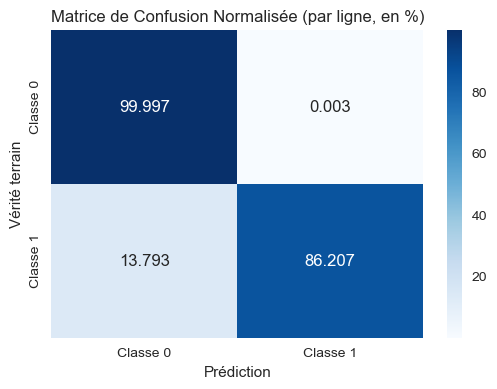

Rapport de classification :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     28641
           1       0.98      0.86      0.92        58

    accuracy                           1.00     28699
   macro avg       0.99      0.93      0.96     28699
weighted avg       1.00      1.00      1.00     28699



In [78]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# 1. Prédictions sur l'ensemble de test
y_pred = best_pipeline_tree.predict(X_val)

# 2. Matrice de confusion normalisée par ligne (pourcentage par classe réelle)
conf_matrix_normalized = confusion_matrix(y_val, y_pred, normalize='true') * 100  # en %

# 3. Affichage de la matrice de confusion normalisée en pourcentage
plt.figure(figsize=(6, 4))
sns.heatmap(conf_matrix_normalized, annot=True, fmt='.3f', cmap='Blues',
            xticklabels=['Classe 0', 'Classe 1'],
            yticklabels=['Classe 0', 'Classe 1'])
plt.title('Matrice de Confusion Normalisée (par ligne, en %)')
plt.xlabel('Prédiction')
plt.ylabel('Vérité terrain')
plt.show()

# 4. Affichage du rapport de classification
print("Rapport de classification :\n", classification_report(y_val, y_pred))


In [79]:
import dill

# Enregistrer le meilleur modèle avec dill
with open('best_Tree.dill', 'wb') as f:
    dill.dump(best_pipeline_tree, f)
    
# Charger le modèle avec dill
with open('best_Tree.dill', 'rb') as f:
    loaded_model = dill.load(f)
# Effectuer une prédiction pour tester le modèle chargé
y_pred = loaded_model.predict(X_val)
print(y_pred)


[0 0 0 ... 0 0 0]


# Modeles ensemblistes

## Modeles parallels : RandomForest

### Baseline

In [83]:

from sklearn.ensemble import RandomForestClassifier
# ----------------------------
# 0. Baseline (modèle par défaut)
# ----------------------------
print("📌 Baseline : RandomForest sans tuning ni sampling")

baseline_pipeline = ImbPipeline([
    ('preproc', preprocessor),
    ('clf', RandomForestClassifier(random_state=42))
])

baseline_pipeline.fit(X_train, y_train)
y_pred_baseline = baseline_pipeline.predict(X_val)
y_proba_baseline = baseline_pipeline.predict_proba(X_val)[:, 1]

print("➡️ Performance du modèle baseline :")
print(f"Accuracy  : {accuracy_score(y_val, y_pred_baseline):.4f}")
print(f"Précision : {precision_score(y_val, y_pred_baseline, zero_division=0):.4f}")
print(f"Rappel    : {recall_score(y_val, y_pred_baseline):.4f}")
print(f"F1-score  : {f1_score(y_val, y_pred_baseline):.4f}")
print(f"ROC AUC   : {roc_auc_score(y_val, y_proba_baseline):.4f}")

print("\n📋 Hyperparamètres par défaut du RandomForest :")
for param, val in baseline_pipeline.named_steps['clf'].get_params().items():
    print(f"{param}: {val}")


📌 Baseline : RandomForest sans tuning ni sampling
➡️ Performance du modèle baseline :
Accuracy  : 0.9993
Précision : 0.8679
Rappel    : 0.7931
F1-score  : 0.8288
ROC AUC   : 0.9998

📋 Hyperparamètres par défaut du RandomForest :
bootstrap: True
ccp_alpha: 0.0
class_weight: None
criterion: gini
max_depth: None
max_features: sqrt
max_leaf_nodes: None
max_samples: None
min_impurity_decrease: 0.0
min_samples_leaf: 1
min_samples_split: 2
min_weight_fraction_leaf: 0.0
monotonic_cst: None
n_estimators: 100
n_jobs: None
oob_score: False
random_state: 42
verbose: 0
warm_start: False


### Tuning and sampling with RandomForest

In [85]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd

# ----------------------------
# 1. Séparation des variables
# ----------------------------
X = df.drop('FraudResult', axis=1)
y = df['FraudResult']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# ----------------------------
# 2. Prétraitement dans un transformer unique
# ----------------------------
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numeric_columns),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
])

# ----------------------------
# 3. Paramètres de recherche pour RandomForest
# ----------------------------
param_grid = {
    'clf__n_estimators': [200, 300],  # Nombre d'arbres
    'clf__max_depth': [10, 20],  # Profondeur maximale
    'clf__min_samples_split': [5, 10],  # Nombre minimal d'échantillons pour diviser un noeud
    'clf__min_samples_leaf': [2, 4],  # Nombre minimal d'échantillons dans une feuille
    'clf__max_features': [None],  # Nombre maximal de caractéristiques
    'clf__random_state': [42]  # Fixation de l'aléa pour reproductibilité
}

# Paramètres avec suréchantillonnage SMOTE
param_grid_smote = param_grid.copy()
param_grid_smote.update({
    'smote__sampling_strategy': [0.25, 0.5]
})

# Paramètres avec sous-échantillonnage
param_grid_under = param_grid.copy()
param_grid_under.update({
    'under__sampling_strategy': [0.25, 0.5]
})


# ----------------------------
# 4. Définition des pipelines imbriqués pour RandomForest
# ----------------------------
pipelines = {
    "RandomForest_Original": ImbPipeline([
        ('preproc', preprocessor),
        ('clf', RandomForestClassifier(random_state=42))
    ]),
    "RandomForest_SMOTE": ImbPipeline([
        ('preproc', preprocessor),
        ('smote', SMOTE(random_state=42)),
        ('clf', RandomForestClassifier(random_state=42))
    ]),
    "RandomForest_UnderSampling": ImbPipeline([
        ('preproc', preprocessor),
        ('under', RandomUnderSampler(random_state=42)),
        ('clf', RandomForestClassifier(random_state=42))
    ]),
    "Pondération": ImbPipeline([
        ('preproc', preprocessor),
        ('clf', RandomForestClassifier(random_state=42, class_weight='balanced'))  # Pondération des classes
   ])     
}

# ----------------------------
# 5. Boucle d’entraînement et évaluation pour RandomForest
# ----------------------------
resultats = []

for methode, pipeline in pipelines.items():
    print(f"\n🔍 Méthode : {methode}")

    if "SMOTE" in methode:
        tuned_parameters = param_grid_smote
    elif "UnderSampling" in methode:
        tuned_parameters = param_grid_under
    else:
        tuned_parameters = param_grid
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)    
    grid = GridSearchCV(pipeline, tuned_parameters, cv=cv, scoring='f1', n_jobs=-1, error_score='raise')
    grid.fit(X_train, y_train)

    best_model = grid.best_estimator_
    y_pred = best_model.predict(X_val)
    y_proba = best_model.predict_proba(X_val)[:, 1]  # Probabilités pour la classe 1

    resultats.append({
        'Méthode': methode,
        'Accuracy': accuracy_score(y_val, y_pred),
        'Précision': precision_score(y_val, y_pred, zero_division=0),
        'Rappel': recall_score(y_val, y_pred),
        'F1-score': f1_score(y_val, y_pred),
        'ROC AUC': roc_auc_score(y_val, y_proba),
        'Best Params': grid.best_params_
    })

# ----------------------------
# 6. Résumé des résultats pour RandomForest
# ----------------------------
df_resultats = pd.DataFrame(resultats)
df_resultats = df_resultats.sort_values(by='F1-score', ascending=False).reset_index(drop=True)

print("\n📊 Résumé des performances pour RandomForest :")
print(df_resultats)



🔍 Méthode : RandomForest_Original

🔍 Méthode : RandomForest_SMOTE

🔍 Méthode : RandomForest_UnderSampling

🔍 Méthode : Pondération

📊 Résumé des performances pour RandomForest :
                      Méthode  Accuracy  Précision    Rappel  F1-score  \
0       RandomForest_Original  0.999617   0.960784  0.844828  0.899083   
1                 Pondération  0.999373   0.822581  0.879310  0.850000   
2          RandomForest_SMOTE  0.999199   0.777778  0.844828  0.809917   
3  RandomForest_UnderSampling  0.992787   0.216730  0.982759  0.355140   

    ROC AUC                                        Best Params  
0  0.982581  {'clf__max_depth': 10, 'clf__max_features': No...  
1  0.965329  {'clf__max_depth': 20, 'clf__max_features': No...  
2  0.973895  {'clf__max_depth': 20, 'clf__max_features': No...  
3  0.998846  {'clf__max_depth': 10, 'clf__max_features': No...  


## récupérer le pipeline optimal pour RandomForest

In [87]:

# Meilleurs hyperparamètres obtenus pour l'Arbre de Décision
best_params = df_resultats[df_resultats['Méthode'] == 'RandomForest_Original']['Best Params'].values[0]
print("Meilleurs hyperparamètres : ", best_params)

# Reconstruire le pipeline final avec Arbre de Décision et original
best_pipeline_RandomForest = ImbPipeline([
    ('preproc', preprocessor), 
    ('clf', RandomForestClassifier(
        n_estimators=best_params['clf__n_estimators'], 
        max_depth=best_params['clf__max_depth'], 
        max_features=best_params['clf__max_features'],  
        min_samples_leaf=best_params['clf__min_samples_leaf'], 
        min_samples_split=best_params['clf__min_samples_split'], 
        random_state=best_params['clf__random_state'] 
    ))
])

# Entraîner le pipeline final
best_pipeline_RandomForest.fit(X_train, y_train)



Meilleurs hyperparamètres :  {'clf__max_depth': 10, 'clf__max_features': None, 'clf__min_samples_leaf': 4, 'clf__min_samples_split': 5, 'clf__n_estimators': 200, 'clf__random_state': 42}


Pipeline(steps=[('preproc',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['Value',
                                                   'SubscriptionId_transaction_count',
                                                   'CustomerId_abs_amount_std',
                                                   'log_CustomerId_abs_amount_sum',
                                                   'Amount_Value_Ecart']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  Index(['ProviderId', 'ProductId', 'ChannelId', 'PricingStrategy',
       'TransactionType', 'TransactionDay', 'MomentOfDay'],
      dtype='object'))])),
                ('clf',
                 RandomForestClassifier(max_depth=10, max_features=None,
                                        min_samples_leaf=4, min_samples_split=5,
                                        n_estimators=200, random_state=42))])

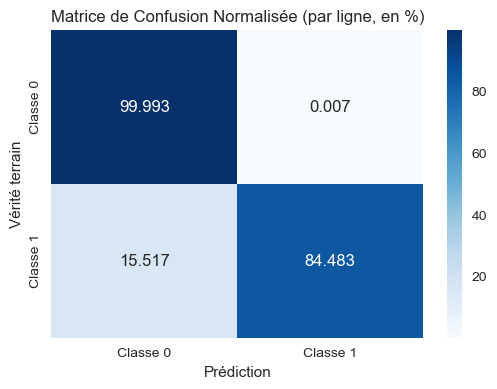

Rapport de classification :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     28641
           1       0.96      0.84      0.90        58

    accuracy                           1.00     28699
   macro avg       0.98      0.92      0.95     28699
weighted avg       1.00      1.00      1.00     28699



In [88]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# 1. Prédictions sur l'ensemble de test
y_pred = best_pipeline_RandomForest.predict(X_val)

# 2. Matrice de confusion normalisée par ligne (pourcentage par classe réelle)
conf_matrix_normalized = confusion_matrix(y_val, y_pred, normalize='true') * 100  # en %

# 3. Affichage de la matrice de confusion normalisée en pourcentage
plt.figure(figsize=(6, 4))
sns.heatmap(conf_matrix_normalized, annot=True, fmt='.3f', cmap='Blues',
            xticklabels=['Classe 0', 'Classe 1'],
            yticklabels=['Classe 0', 'Classe 1'])
plt.title('Matrice de Confusion Normalisée (par ligne, en %)')
plt.xlabel('Prédiction')
plt.ylabel('Vérité terrain')
plt.show()

# 4. Affichage du rapport de classification
print("Rapport de classification :\n", classification_report(y_val, y_pred))


In [89]:
import dill

# Enregistrer le meilleur modèle avec dill
with open('best_RandomForest.dill', 'wb') as f:
    dill.dump(best_pipeline_RandomForest, f)
    
# Charger le modèle avec dill
with open('best_RandomForest.dill', 'rb') as f:
    loaded_model = dill.load(f)
# Effectuer une prédiction pour tester le modèle chargé
y_pred = loaded_model.predict(X_val)
print(y_pred)


[0 0 0 ... 0 0 0]


## Modeles sequentiels : lightGBM

### Baseline

In [92]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as ImbPipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd

# ----------------------------
# 1. Séparation des variables
# ----------------------------
X = df.drop('FraudResult', axis=1)
y = df['FraudResult']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# ----------------------------
# 2. Prétraitement
# ----------------------------
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numeric_columns),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
])

# ----------------------------
# 0. Baseline (modèle par défaut)
# ----------------------------
print("📌 Baseline : LightGBM sans tuning ni sampling")

baseline_pipeline = ImbPipeline([
    ('preproc', preprocessor),
    ('clf', LGBMClassifier(random_state=42))
])

baseline_pipeline.fit(X_train, y_train)
y_pred_baseline = baseline_pipeline.predict(X_val)
y_proba_baseline = baseline_pipeline.predict_proba(X_val)[:, 1]

print("➡️ Performance du modèle baseline :")
print(f"Accuracy  : {accuracy_score(y_val, y_pred_baseline):.4f}")
print(f"Précision : {precision_score(y_val, y_pred_baseline, zero_division=0):.4f}")
print(f"Rappel    : {recall_score(y_val, y_pred_baseline):.4f}")
print(f"F1-score  : {f1_score(y_val, y_pred_baseline):.4f}")
print(f"ROC AUC   : {roc_auc_score(y_val, y_proba_baseline):.4f}")

# ----------------------------
# Affichage des hyperparamètres par défaut
# ----------------------------
print("\n📋 Hyperparamètres par défaut de LightGBM :")
for param, val in baseline_pipeline.named_steps['clf'].get_params().items():
    print(f"{param}: {val}")


📌 Baseline : LightGBM sans tuning ni sampling
[LightGBM] [Info] Number of positive: 135, number of negative: 66828
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001879 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1077
[LightGBM] [Info] Number of data points in the train set: 66963, number of used features: 25
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002016 -> initscore=-6.204603
[LightGBM] [Info] Start training from score -6.204603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
➡️ Performance du modèle baseline :
Accuracy  : 0.9984
Précision : 0.5714
Rappel    : 0.7586
F1-score  : 0.6519
ROC AUC   : 0.8789

📋 Hyperparamètres par défaut de LightGBM :
boosting_type: gbdt
class_weight: None
colsample_bytree: 1.0
importance_type: split
learning_rate: 0.1
max_depth: -1
min_child_samples: 20
min_child

### Tuning and sampling with LightGBM

In [94]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd

# ----------------------------
# 1. Séparation des variables
# ----------------------------
X = df.drop('FraudResult', axis=1)
y = df['FraudResult']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# ----------------------------
# 2. Prétraitement dans un transformer unique
# ----------------------------
preprocessor = ColumnTransformer(transformers=[
    ('num', StandardScaler(), numeric_columns),
    ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_columns)
])

# ----------------------------
# 3. Paramètres de recherche pour LGBM
# ----------------------------
param_grid = {
    'clf__n_estimators': [200, 300],
    'clf__max_depth': [10, 20],
    'clf__learning_rate': [0.05, 0.2],
    'clf__num_leaves': [20, 40],
    'clf__random_state': [42]
}

# Paramètres avec SMOTE
param_grid_smote = param_grid.copy()
param_grid_smote.update({
    'smote__sampling_strategy': [0.25, 0.5]
})

# Paramètres avec sous-échantillonnage
param_grid_under = param_grid.copy()
param_grid_under.update({
    'under__sampling_strategy': [0.25, 0.5]
})

# ----------------------------
# 4. Définition des pipelines pour LGBM
# ----------------------------
pipelines = {
    "LightGBM_Original": ImbPipeline([
        ('preproc', preprocessor),
        ('clf', LGBMClassifier(random_state=42))
    ]),
    "LightGBM_SMOTE": ImbPipeline([
        ('preproc', preprocessor),
        ('smote', SMOTE(random_state=42)),
        ('clf', LGBMClassifier(random_state=42))
    ]),
    "LightGBM_UnderSampling": ImbPipeline([
        ('preproc', preprocessor),
        ('under', RandomUnderSampler(random_state=42)),
        ('clf', LGBMClassifier(random_state=42))
    ]),
    "Pondération": ImbPipeline([
        ('preproc', preprocessor),
        ('clf', LGBMClassifier(random_state=42, class_weight='balanced'))
    ])
}

# ----------------------------
# 5. Boucle d’entraînement et évaluation pour LGBM
# ----------------------------
resultats = []

for methode, pipeline in pipelines.items():
    print(f"\n🔍 Méthode : {methode}")

    if "SMOTE" in methode:
        tuned_parameters = param_grid_smote
    elif "UnderSampling" in methode:
        tuned_parameters = param_grid_under
    else:
        tuned_parameters = param_grid
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)    
    grid = GridSearchCV(pipeline, tuned_parameters, cv=cv, scoring='f1', n_jobs=-1, error_score='raise')
    grid.fit(X_train, y_train)

    best_model = grid.best_estimator_
    y_pred = best_model.predict(X_val)
    y_proba = best_model.predict_proba(X_val)[:, 1]

    resultats.append({
        'Méthode': methode,
        'Accuracy': accuracy_score(y_val, y_pred),
        'Précision': precision_score(y_val, y_pred, zero_division=0),
        'Rappel': recall_score(y_val, y_pred),
        'F1-score': f1_score(y_val, y_pred),
        'ROC AUC': roc_auc_score(y_val, y_proba),
        'Best Params': grid.best_params_
    })

# ----------------------------
# 6. Résumé des résultats pour LGBM
# ----------------------------
df_resultats = pd.DataFrame(resultats)
df_resultats = df_resultats.sort_values(by='F1-score', ascending=False).reset_index(drop=True)

print("\n📊 Résumé des performances pour LightGBM :")
print(df_resultats)



🔍 Méthode : LightGBM_Original
[LightGBM] [Info] Number of positive: 135, number of negative: 66828
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001744 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1077
[LightGBM] [Info] Number of data points in the train set: 66963, number of used features: 25
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.002016 -> initscore=-6.204603
[LightGBM] [Info] Start training from score -6.204603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

## récupérer le pipeline optimal pour LightGBM

In [175]:
import lightgbm as lgb
from imblearn.pipeline import Pipeline as ImbPipeline  # Assure-toi d'importer la bonne classe Pipeline

# Meilleurs hyperparamètres obtenus pour LightGBM
best_params = df_resultats[df_resultats['Méthode'] == 'LightGBM_SMOTE']['Best Params'].values[0]
print("Meilleurs hyperparamètres : ", best_params)

# Reconstruire le pipeline final avec LightGBM
best_pipeline_LightGBM = ImbPipeline([
    ('preproc', preprocessor),  
    ('smote', SMOTE(sampling_strategy=best_params['smote__sampling_strategy'])),  # Application de SMOTE
    ('clf', lgb.LGBMClassifier(
        learning_rate=best_params['clf__learning_rate'],  # Taux d'apprentissage
        max_depth=best_params['clf__max_depth'],          # Profondeur maximale des arbres
        n_estimators=best_params['clf__n_estimators'],    # Nombre d'arbres
        num_leaves=best_params['clf__num_leaves'],        # Nombre de feuilles par arbre
        random_state=best_params['clf__random_state']     # Pour la reproductibilité
    ))
])

# Entraîner le pipeline final
best_pipeline_LightGBM.fit(X_train, y_train)



Meilleurs hyperparamètres :  {'clf__learning_rate': 0.2, 'clf__max_depth': 10, 'clf__n_estimators': 200, 'clf__num_leaves': 20, 'clf__random_state': 42, 'smote__sampling_strategy': 0.25}
[LightGBM] [Info] Number of positive: 16707, number of negative: 66828
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003259 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5975
[LightGBM] [Info] Number of data points in the train set: 83535, number of used features: 25
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.200000 -> initscore=-1.386294
[LightGBM] [Info] Start training from score -1.386294
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furthe

Pipeline(steps=[('preproc',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['Value',
                                                   'SubscriptionId_transaction_count',
                                                   'CustomerId_abs_amount_std',
                                                   'log_CustomerId_abs_amount_sum',
                                                   'Amount_Value_Ecart']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  Index(['ProviderId', 'ProductId', 'ChannelId', 'PricingStrategy',
       'TransactionType', 'TransactionDay', 'MomentOfDay'],
      dtype='object'))])),
                ('smote', SMOTE(sampling_strategy=0.25)),
                ('clf',
                 LGBMClassifier(learning_rate=0.2, max_depth=10,
                                n_estimators=200, num_leaves=20,
                                random_state=42))])

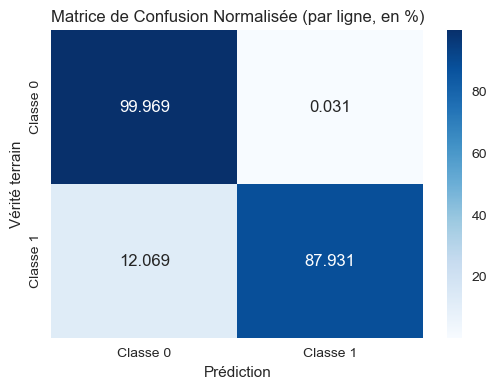

Rapport de classification :
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     28641
           1       0.85      0.88      0.86        58

    accuracy                           1.00     28699
   macro avg       0.92      0.94      0.93     28699
weighted avg       1.00      1.00      1.00     28699



In [97]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# 1. Prédictions sur l'ensemble de test
y_pred = best_pipeline_LightGBM.predict(X_val)

# 2. Matrice de confusion normalisée par ligne (pourcentage par classe réelle)
conf_matrix_normalized = confusion_matrix(y_val, y_pred, normalize='true') * 100  # en %

# 3. Affichage de la matrice de confusion normalisée en pourcentage
plt.figure(figsize=(6, 4))
sns.heatmap(conf_matrix_normalized, annot=True, fmt='.3f', cmap='Blues',
            xticklabels=['Classe 0', 'Classe 1'],
            yticklabels=['Classe 0', 'Classe 1'])
plt.title('Matrice de Confusion Normalisée (par ligne, en %)')
plt.xlabel('Prédiction')
plt.ylabel('Vérité terrain')
plt.show()

# 4. Affichage du rapport de classification
print("Rapport de classification :\n", classification_report(y_val, y_pred))

In [98]:
import dill
from pathlib import Path

# Définir le chemin relatif vers le dossier models/
MODEL_DIR = Path("../models")
MODEL_DIR.mkdir(exist_ok=True)  # Facultatif, à ne garder que si tu veux créer si absent

MODEL_PATH = MODEL_DIR / "best_SMOTE_LightGBM.dill"

# Enregistrer le meilleur modèle
with open(MODEL_PATH, 'wb') as f:
    dill.dump(best_pipeline_LightGBM, f)

print(f"Modèle enregistré dans : {MODEL_PATH}")

# Charger le modèle
with open(MODEL_PATH, 'rb') as f:
    loaded_model = dill.load(f)

# Tester la prédiction
y_pred = loaded_model.predict(X_val)
print(y_pred)



[0 0 0 ... 0 0 0]


# Choix du modele : LightGBM_SMOTE
   ##  avec les hyperparamètres optimisés : 
      {'clf__learning_rate': 0.2,
      'clf__max_depth': 10,  
      'clf__n_estimators': 200, 
      'clf__num_leaves': 20, 
      'smote__sampling_strategy': 0.25}

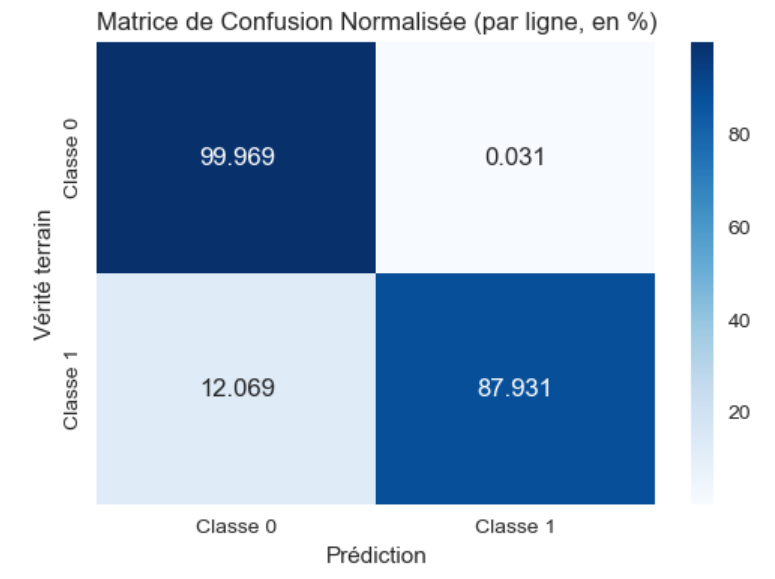
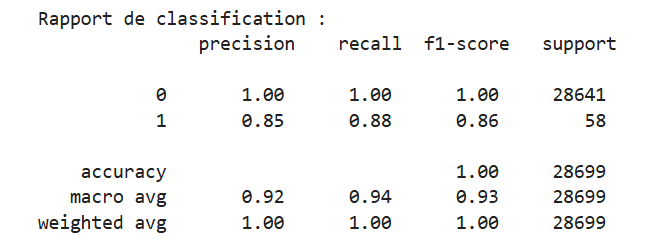

# Sharp pour le modele choisi

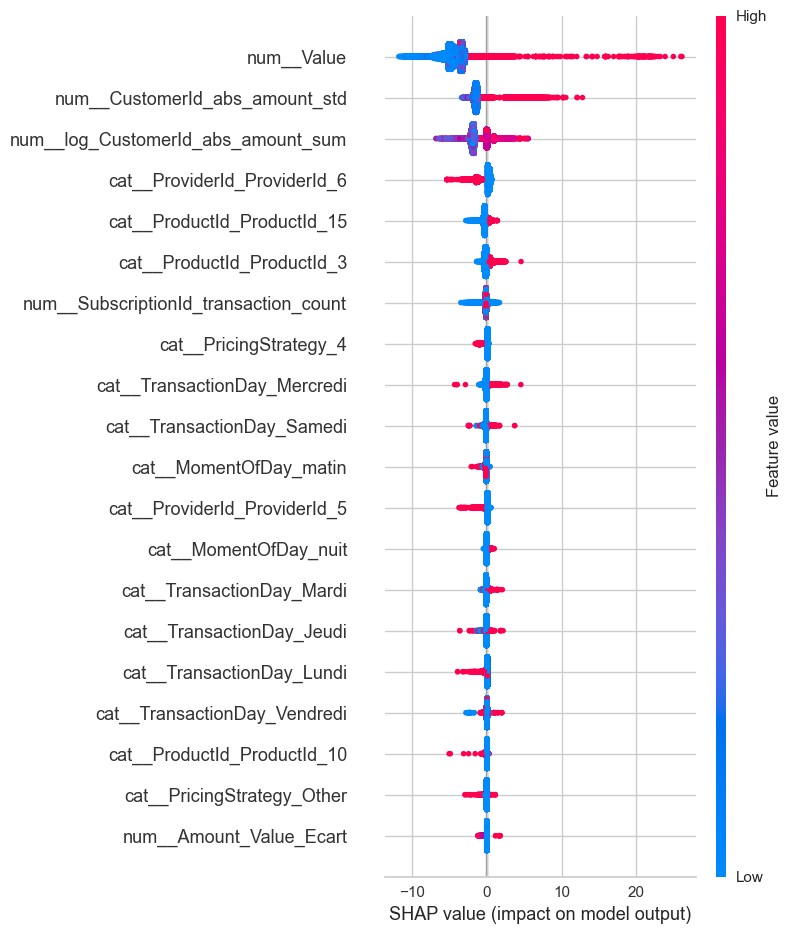

In [193]:
import shap
import dill
import numpy as np

# 1. Extraire les composants du pipeline
preprocessor = best_pipeline_LightGBM.named_steps['preproc']
model = best_pipeline_LightGBM.named_steps['clf']

# 2. Appliquer la transformation sur X_train
X_transformed = preprocessor.transform(X_train)

# 3. Convertir en array si nécessaire (utile si X_transformed est sparse)
if hasattr(X_transformed, 'toarray'):
    X_transformed = X_transformed.toarray()

# 4. Récupérer les noms de variables après transformation
feature_names = preprocessor.get_feature_names_out()

# 5. Créer l'explainer SHAP pour le modèle LightGBM
explainer_LightGBM = shap.TreeExplainer(model)

# 6. Calculer les valeurs SHAP (désactiver le check d’additivité pour éviter les erreurs)
shap_values_LightGBM = explainer_LightGBM(X_transformed, check_additivity=False)

# 7. Enregistrer les valeurs SHAP
with open('shap_values_LightGBM.dill', 'wb') as f:
    dill.dump(shap_values_LightGBM, f)

# 8. Recharger les valeurs SHAP
with open('shap_values_LightGBM.dill', 'rb') as f:
    loaded_shap_values_LightGBM = dill.load(f)

# 9. Visualisation globale (summary plot)
shap.summary_plot(loaded_shap_values_LightGBM, X_transformed, feature_names=feature_names)


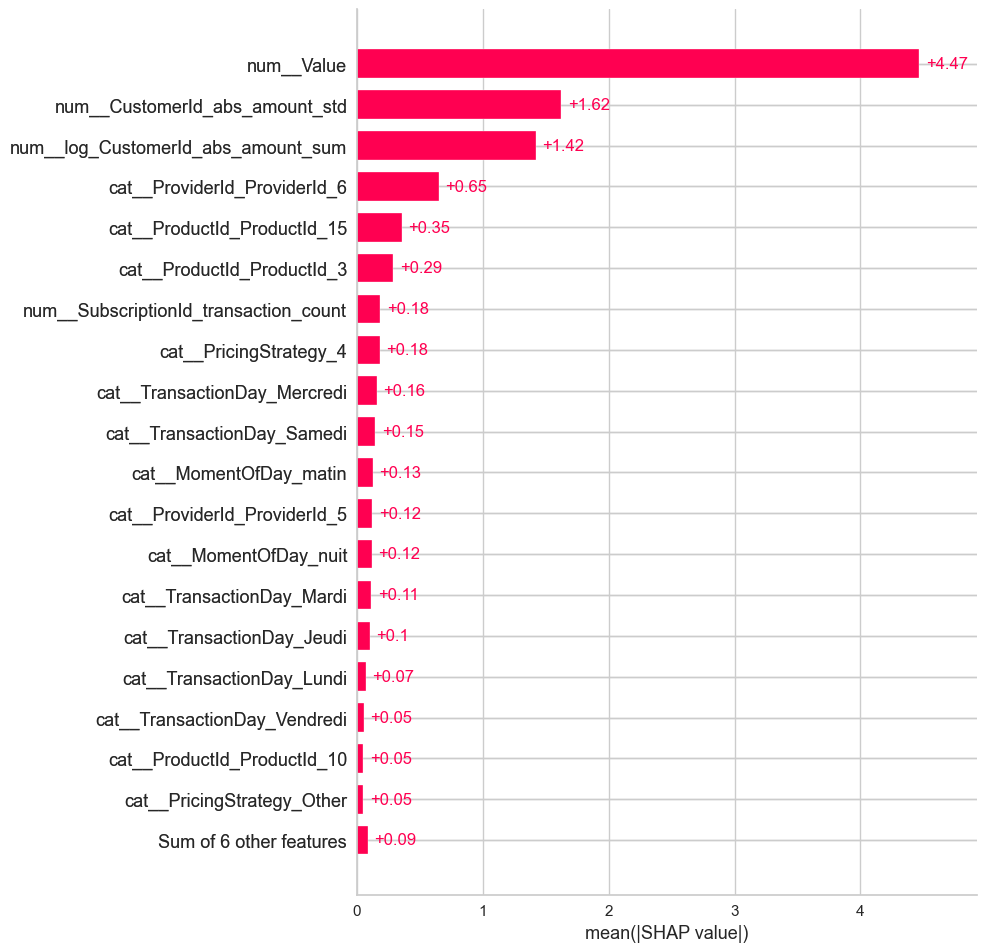

In [197]:
import shap

# Recréer un nouvel objet Explanation avec les bons noms
shap_values_corrected = shap.Explanation(
    values=loaded_shap_values_LightGBM.values,
    base_values=loaded_shap_values_LightGBM.base_values,
    data=X_transformed,
    feature_names=feature_names
)

# Maintenant tu peux afficher le bar chart avec les bons noms
shap.plots.bar(shap_values_corrected, max_display=20)


# FIN